<a href="https://colab.research.google.com/github/barauna-lo/Artificial_Inteligence/blob/main/CAP345_Artificial_Intelience_AT01_02.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

[<img src=https://raw.githubusercontent.com/barauna-lo/CAP4213-Deep-Learning/main/logoinpe.png align=”middle”>](https://www.gov.br/inpe/pt-br)

[<center><img src="https://github.com/barauna-lo/CAP4213-Deep-Learning/blob/main/LogoCAP.png?raw=true" width = 500 align="middle"></center>](http://www.inpe.br/posgraduacao/cap/)


# CAP-345-3 - Inteligência Artificial

* Aline Nascimento
* Lourenço Cavalcante
* Luan Orion Baraúna

These code was provide for [this](https://sites.google.com/view/ia-inpe-2022/) course. 




# Atividade 1 - Análise do problema e dos dados

1) Considere os conceitos apresentados em aula e o problema apresentado pela Dra. Tahisa (apres_problema.pdf)
link: https://drive.google.com/file/d/1OzCFj26aTVmw-dEAGhAhTbv2kFO2K7YD/view?usp=sharing

 
Apresente a introdução de um artigo (seção 1) em um documento no formato (IEEE) (https://www.ieee.org/conferences/publishing/templates.html), contendo: 
A descrição do problema, a motivação, os objetivos, possíveis técnicas a serem empregadas e resultados esperados.  
 
2) Considere os dados disponíveis nos arquivos .csv: 

Conjunto 1 – 1o período: 
   1. Sentinel 1. Data: 28-05-2022 
   2. Sentinel 2. Data: 31-05-2022 

Conjunto 2 – 2o período: 
   1. Sentinel 1. Data: 07-10-2022 
   2. Sentinel 2. Data: 08-10-2022 

Apresente a análise e tratamento dos dados (seção 2) no mesmo documento no formato IEEE.

   a) descreva as entradas e saídas para o problema considerado;

   b) descreva informações dos conjuntos de dados; 
   
   c) descreva e apresente análises de possíveis dados faltantes e outliers; 
   
   d) descreva e apresente análises estatísticas dos dados; 
   
   e) descreva e apresente possíveis correlações dos dados; 
 
As análises podem ser feitas no Orange ou com bibliotecas Python ou R. 
O trabalho pode ser feito em grupo de até 3 pessoas. Cada um deve postar a atividade (arquivos .pdf e programa), com indicação da composição do grupo.

Data de postagem: 22/04/2022


===============

ATENÇÃO: Os dados anteriormente compartilhados podem apresentar dificuldades na fase de leitura. 
Estamos disponibilizando os mesmos dados em formato diferente, no link abaixo.

https://drive.google.com/drive/folders/1jLUUUl-KcNOaDWGRkivA6C5g-gE7FZUd?usp=sharing


# 1) Introdução:

Nesta atividade iremos utilizar dados provenientes da segmentação de imagens dos satélites Sentinel-1 e Senltinel-2. O objetivo é utilizarmos uma técnica de aprendizagem de máquina que possa classificar os dados de modo a obtermos uma classificação de uso e mudança do solo semelhante ao Mapa de Mudança de Uso e do Solo do Mapbiomas para a região do Mato Grosso - Brasil.
O Mapbiomas utilizou para a criação do mapa citado imagens multiespectrais do satélite Landsat. Neste trabalho há o diferencial de que utilizaremos os dados multiespectrais do Sentinel-2 e dados SAR do Sentinel-1.

<img src="https://sentinels.copernicus.eu/image/image_gallery?uuid=08fbcb73-881e-4cff-a330-eb526a8c06f1&groupId=247904&t=1359606594070" width=500>

<img src="https://sentinels.copernicus.eu/image/image_gallery?uuid=486584ef-68fa-4f46-85c4-573983bd350f&groupId=247904&t=1346165488177" width=485>



Mais detalhes podem ser encontrado [nesta](https://www.overleaf.com/read/xwtdcgxpnytc) versão do Overleaf.

# 2) Considere os dados disponíveis nos arquivos .csv: 


In [2]:
!pip install geopandas

     |████████████████████████████████| 1.0 MB 5.1 MB/s 
     |████████████████████████████████| 6.3 MB 51.2 MB/s 
     |████████████████████████████████| 16.7 MB 424 kB/s 


In [3]:
#Import Libraries 📚
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from matplotlib.pyplot import figure
import seaborn as sns
import geopandas as gpd
## set a grey background (use sns.set_theme() if seaborn version 0.11.0 or above) 
#sns.set(style="darkgrid")

In [4]:
#Downloading data frames from Google Drive
!gdown --id 12l96KuvmDKNskSe8Zzf0yt-DwKwb_uPh
!gdown --id 1RUSxSQX5bYIsr4ewGM_u0jRs3-edj7ze
!gdown --id 1funnNkha2LANOsXtSZus0iZAD6R3_5xR
!gdown --id 1uu1pH1_Y1ztqg8ugSkwc7lNqiRBSdMuz
!gdown --id 10Nb8cbbl62gHcaI7B_L5gG9OTua7b0Zl
!gdown --id 1S2H3LpPAu-Z22RUuQl0XV-fToRco5Oej

/usr/local/lib/python3.7/dist-packages/gdown/cli.py:131: FutureWarning: Option `--id` was deprecated in version 4.3.1 and will be removed in 5.0. You don't need to pass it anymore to use a file ID.
  category=FutureWarning,
Downloading...
From: https://drive.google.com/uc?id=12l96KuvmDKNskSe8Zzf0yt-DwKwb_uPh
To: /content/S120200528.csv
100% 36.1M/36.1M [00:00<00:00, 116MB/s]
/usr/local/lib/python3.7/dist-packages/gdown/cli.py:131: FutureWarning: Option `--id` was deprecated in version 4.3.1 and will be removed in 5.0. You don't need to pass it anymore to use a file ID.
  category=FutureWarning,
Downloading...
From: https://drive.google.com/uc?id=1RUSxSQX5bYIsr4ewGM_u0jRs3-edj7ze
To: /content/S120201007.csv
100% 36.4M/36.4M [00:00<00:00, 119MB/s] 
/usr/local/lib/python3.7/dist-packages/gdown/cli.py:131: FutureWarning: Option `--id` was deprecated in version 4.3.1 and will be removed in 5.0. You don't need to pass it anymore to use a file ID.
  category=FutureWarning,
Downloading...
From

In [5]:
#Reading the data and Sorting in cresceting order in DN Classes
Sent1Outono=pd.read_csv('S120200528.csv') #Sentinel-1 Date 1
Sent1Primavera=pd.read_csv('S120201007.csv') #Sentinel-1 Date 2
Sent2Outono=pd.read_csv('S220200531.csv') #Sentinel-2 Date 1
Sent2Primavera=pd.read_csv('S220201008.csv') #Sentinel-2 Date 2

## a) descreva as entradas e saídas para o problema considerado;
As entradas do problema são dois dataframes (.csv) que possuem métricas estatísticas dos dados dos sensores dos satélites Sentinel-1 e Sentinel-2, esses dataframes foram criados a partir do Qgis e são fruto de uma técnica de segmentação de imagens, com isso, os dados estão classificados de acordo com a seguimentação criada, O campo que se refere às classes nos dataframes é o `DN`. 
Do Sentinel-2 as métricas foram criadas a partir dos dados das bandas espectrais que possuem diversas resoluções espaciais (10m, 20m e 60m), na figura 1b é possível visualizar as resoluções e as métricas das bandas, é possível visualizar os dados em si a partir do comando `df.columns`.
Do Sentinel-1 as métricas são dos dados SAR no modo IW, nas polarizações VV e VH.
Para algumas análises e utilização de técnicas de aprendizagem de máquina, utilizaremos também as informações geoespaciais dos dados no formato geopackage.

O problema abordado nesta atividade é de **CLASSIFICAÇÃO**. Assim, utilizaremos os dados descritos acima em algoritmos de Machine learning de modo a obtermos uma classificação de boa qualidade e próxima à realidade descrita do Mapa de Uso e Mudança do Solo do Mapbiomas.

In [6]:
Sent1Outono.columns

Index(['fid', 'DN', 'S1_20200528_VHcount', 'S1_20200528_VHsum',
       'S1_20200528_VHmean', 'S1_20200528_VHmedian', 'S1_20200528_VHstdev',
       'S1_20200528_VHmin', 'S1_20200528_VHmax', 'S1_20200528_VHrange',
       'S1_20200528_VHminority', 'S1_20200528_VHmajority',
       'S1_20200528_VHvariety', 'S1_20200528_VHvariance',
       'S1_20200528_VV_count', 'S1_20200528_VV_sum', 'S1_20200528_VV_mean',
       'S1_20200528_VV_median', 'S1_20200528_VV_stdev', 'S1_20200528_VV_min',
       'S1_20200528_VV_max', 'S1_20200528_VV_range', 'S1_20200528_VV_minority',
       'S1_20200528_VV_majority', 'S1_20200528_VV_variety',
       'S1_20200528_VV_variance'],
      dtype='object')

In [7]:
Sent2Outono.columns

Index(['fid', 'DN', '20200531_S2_B1_count', '20200531_S2_B1_sum',
       '20200531_S2_B1_mean', '20200531_S2_B1_median', '20200531_S2_B1_stdev',
       '20200531_S2_B1_min', '20200531_S2_B1_max', '20200531_S2_B1_range',
       ...
       '20200531_S2_B12_mean', '20200531_S2_B12_median',
       '20200531_S2_B12_stdev', '20200531_S2_B12_min', '20200531_S2_B12_max',
       '20200531_S2_B12_range', '20200531_S2_B12_minority',
       '20200531_S2_B12_majority', '20200531_S2_B12_variety',
       '20200531_S2_B12_variance'],
      dtype='object', length=158)

**Bandas Espectrais Sentinel-2**

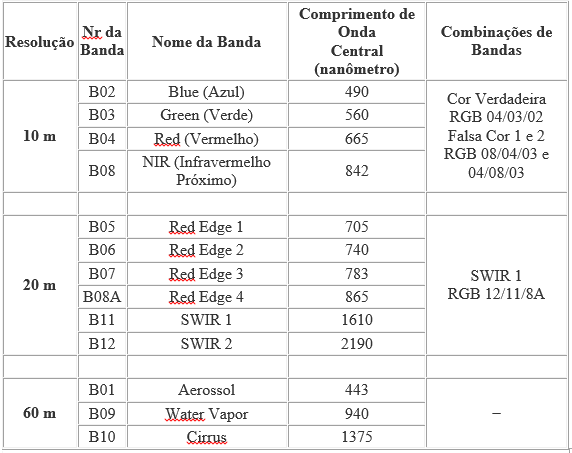

## b) descreva informações dos conjuntos de dados; 

Os dados são provenientes de um processo de [_Segmentação de Imagens_](https://en.wikipedia.org/wiki/Image_segmentation) das imagens extraídas do satélites [Sentinel-1](https://sentinels.copernicus.eu/web/sentinel/missions/sentinel-1) e [Sentinel-2](https://sentinels.copernicus.eu/web/sentinel/missions/sentinel-2) em 4 conjuntos de dados diferentes proveniente dos dois satélites em datas diferentes. 

As segmentações possuem uma identificação na coluna `fid`, uma classe associada a classificação do [MapBiomas Brasil Coleção 06](https://mapbiomas.org/estatisticas) `DN` e um conjunto de atributos separados alocados nas colunas. Cada conjunto de dados possui uma quantidade de atributos diferentes.

In [8]:
print('Sentinel-1 \n' ,len(Sent1Outono.columns) , 'for  2020/05/28' , ' and  ' , len(Sent1Primavera.columns), 'for  2020/10/07')
print('Sentinel-2 \n' ,len(Sent2Outono.columns) , 'for  2020/05/31' , ' and  ' , len(Sent2Primavera.columns), 'for  2020/10/08')

Sentinel-1 
 26 for  2020/05/28  and   26 for  2020/10/07
Sentinel-2 
 158 for  2020/05/31  and   158 for  2020/10/08


## c) Descreva e apresente análises de possíveis dados faltantes e outliers;

Procurando por dados nulos em cada um dos conjuntos de dados.

In [9]:
print('Sentinel-1 Data 1\n',Sent1Outono.isna().sum(),'\n')
print('Sentinel-1 Data 2\n',Sent1Primavera.isna().sum(),'\n')
print('Sentinel-2 Data 1\n',Sent2Outono.isna().sum(),'\n')
print('Sentinel-2 Data 2\n',Sent2Primavera.isna().sum(),'\n')

Sentinel-1 Data 1
 fid                        0
DN                         0
S1_20200528_VHcount        0
S1_20200528_VHsum          0
S1_20200528_VHmean         0
S1_20200528_VHmedian       0
S1_20200528_VHstdev        0
S1_20200528_VHmin          0
S1_20200528_VHmax          0
S1_20200528_VHrange        0
S1_20200528_VHminority     0
S1_20200528_VHmajority     0
S1_20200528_VHvariety      0
S1_20200528_VHvariance     0
S1_20200528_VV_count       0
S1_20200528_VV_sum         0
S1_20200528_VV_mean        0
S1_20200528_VV_median      0
S1_20200528_VV_stdev       0
S1_20200528_VV_min         0
S1_20200528_VV_max         0
S1_20200528_VV_range       0
S1_20200528_VV_minority    0
S1_20200528_VV_majority    0
S1_20200528_VV_variety     0
S1_20200528_VV_variance    0
dtype: int64 

Sentinel-1 Data 2
 fid                        0
DN                         0
20201007_S1_VH_count       0
20201007_S1_VH_sum         0
20201007_S1_VH_mean        0
20201007_S1_VH_median      0
20201007_S1_VH_stde

In [10]:
#Ploting data Frame Shaping
print(Sent1Outono.shape)
print(Sent1Primavera.shape)
print(Sent2Outono.shape)
print(Sent2Primavera.shape)

(90064, 26)
(90064, 26)
(90064, 158)
(90064, 158)


In [11]:
# We trying the @Rogerio ideia to drop colluns
Sent1Outono.dropna(inplace=True)
Sent1Outono.reset_index(inplace=True, drop=True)

Sent1Primavera.dropna(inplace=True)
Sent1Primavera.reset_index(inplace=True, drop=True)

Sent2Outono.dropna(inplace=True)
Sent2Outono.reset_index(inplace=True, drop=True)

Sent2Primavera.dropna(inplace=True)
Sent2Primavera.reset_index(inplace=True, drop=True)

print(Sent1Outono.shape)
print(Sent1Primavera.shape)
print(Sent2Outono.shape)
print(Sent2Primavera.shape)

(90064, 26)
(90064, 26)
(90043, 158)
(90043, 158)


Iremos deletar todas as linhas que possírem dados nulos em todas as colunas.

In [12]:
print('Sentinel-1 Data 1\n',Sent1Outono.isna().sum(),'\n')
print('Sentinel-1 Data 2\n',Sent1Primavera.isna().sum(),'\n')
print('Sentinel-2 Data 1\n',Sent2Outono.isna().sum(),'\n')
print('Sentinel-2 Data 2\n',Sent2Primavera.isna().sum(),'\n')

Sentinel-1 Data 1
 fid                        0
DN                         0
S1_20200528_VHcount        0
S1_20200528_VHsum          0
S1_20200528_VHmean         0
S1_20200528_VHmedian       0
S1_20200528_VHstdev        0
S1_20200528_VHmin          0
S1_20200528_VHmax          0
S1_20200528_VHrange        0
S1_20200528_VHminority     0
S1_20200528_VHmajority     0
S1_20200528_VHvariety      0
S1_20200528_VHvariance     0
S1_20200528_VV_count       0
S1_20200528_VV_sum         0
S1_20200528_VV_mean        0
S1_20200528_VV_median      0
S1_20200528_VV_stdev       0
S1_20200528_VV_min         0
S1_20200528_VV_max         0
S1_20200528_VV_range       0
S1_20200528_VV_minority    0
S1_20200528_VV_majority    0
S1_20200528_VV_variety     0
S1_20200528_VV_variance    0
dtype: int64 

Sentinel-1 Data 2
 fid                        0
DN                         0
20201007_S1_VH_count       0
20201007_S1_VH_sum         0
20201007_S1_VH_mean        0
20201007_S1_VH_median      0
20201007_S1_VH_stde

In [13]:
Sent1Outono = Sent1Outono.drop(Sent1Outono.index[[0,1]])
Sent1Primavera = Sent1Primavera.drop(Sent1Primavera.index[[0,1]])
Sent2Outono = Sent2Outono.drop(Sent2Outono.index[[0,1]])
Sent2Primavera = Sent2Primavera.drop(Sent2Primavera.index[[0,1]])

In [14]:
print('Sentinel-1 Data 1\n',Sent1Outono.isna().sum(),'\n')
print('Sentinel-1 Data 2\n',Sent1Primavera.isna().sum(),'\n')
print('Sentinel-2 Data 1\n',Sent2Outono.isna().sum(),'\n')
print('Sentinel-2 Data 2\n',Sent2Primavera.isna().sum(),'\n')

Sentinel-1 Data 1
 fid                        0
DN                         0
S1_20200528_VHcount        0
S1_20200528_VHsum          0
S1_20200528_VHmean         0
S1_20200528_VHmedian       0
S1_20200528_VHstdev        0
S1_20200528_VHmin          0
S1_20200528_VHmax          0
S1_20200528_VHrange        0
S1_20200528_VHminority     0
S1_20200528_VHmajority     0
S1_20200528_VHvariety      0
S1_20200528_VHvariance     0
S1_20200528_VV_count       0
S1_20200528_VV_sum         0
S1_20200528_VV_mean        0
S1_20200528_VV_median      0
S1_20200528_VV_stdev       0
S1_20200528_VV_min         0
S1_20200528_VV_max         0
S1_20200528_VV_range       0
S1_20200528_VV_minority    0
S1_20200528_VV_majority    0
S1_20200528_VV_variety     0
S1_20200528_VV_variance    0
dtype: int64 

Sentinel-1 Data 2
 fid                        0
DN                         0
20201007_S1_VH_count       0
20201007_S1_VH_sum         0
20201007_S1_VH_mean        0
20201007_S1_VH_median      0
20201007_S1_VH_stde

É possível Identificar os outliers de cada coluna dos dados a partir do estudo de quantis. Essa análise é realizada para cada coluna de modo a obtermos uma melhor distriuição dos dados de cada coluna de um dataframe. 
É possível ver o exemplo dessa distribuição no histograma abaixo. 

In [15]:
def remove_outliers(dataframe, col):
  valor = dataframe[col]
  print(col)
  Q1 = valor.quantile(.25)
  Q3 = valor.quantile(.75)
  IIQ = Q3 - Q1
  limite_inferior = Q1 - 1.5 * IIQ
  limite_superior = Q3 + 1.5 * IIQ
  selecao = (valor >=limite_inferior) & (valor <= limite_superior)
  dataframe_new = dataframe[selecao]
  return dataframe_new

def remove_outliers_from_dataframe(dataframe):
  dataframe_new = dataframe
  for col in dataframe.columns:
    if col != 'fid' or col != 'DN':
      dataframe_new = remove_outliers(dataframe, col)
    dataframe_new
  return dataframe_new

In [16]:
Sent1Outono_new = remove_outliers(Sent1Outono,'S1_20200528_VHmean')

S1_20200528_VHmean


array([[<matplotlib.axes._subplots.AxesSubplot object at 0x7fccd6979510>]],
      dtype=object)

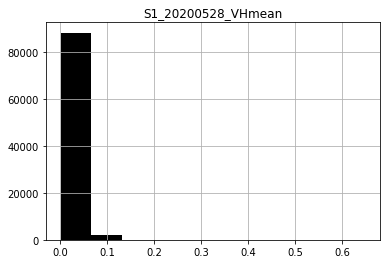

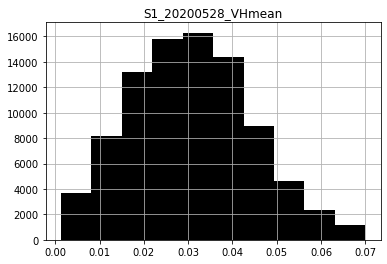

In [17]:
Sent1Outono.hist(['S1_20200528_VHmean'], color='black')
Sent1Outono_new.hist(['S1_20200528_VHmean'], color='black')

## d) descreva e apresente análises estatísticas dos dados;

A primeira pergunta que procuraremos responder é sobre a distribuição de segmentação por classes em cada um dos conjuntos de dados.

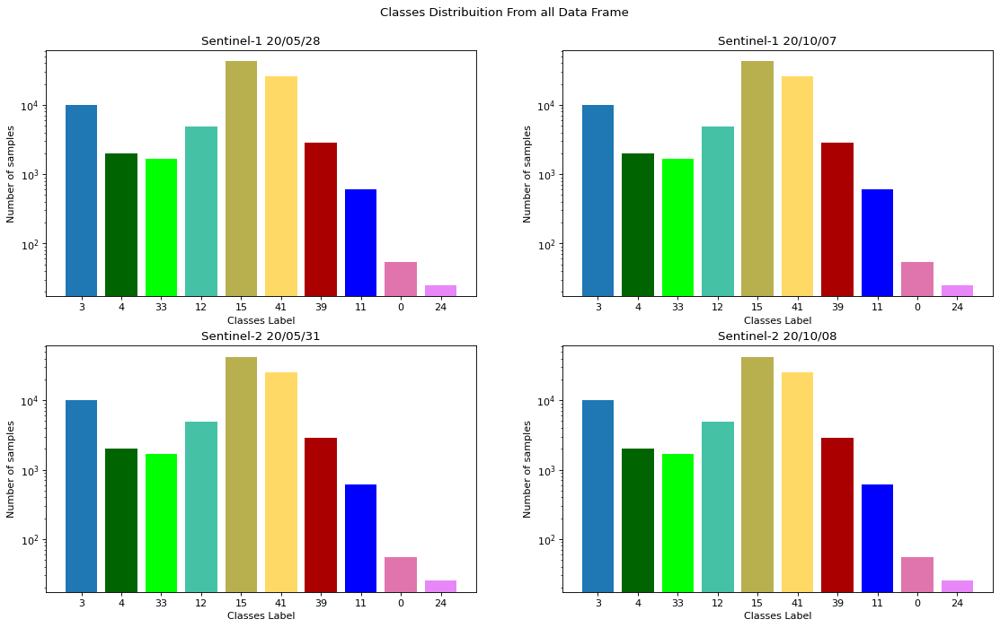

In [18]:
from collections import Counter
#Alocating Frequency Data
freqs = [Counter(Sent1Outono['DN'].values),
         Counter(Sent1Primavera['DN'].values),
         Counter(Sent2Outono['DN'].values),
         Counter(Sent2Primavera['DN'].values)]
#Alocanting Classes Values
xvals = []
for i in range(len(freqs)):
  xvals.append(range(len(freqs[i].values())) )
#Titles Classes
titles =['Sentinel-1 20/05/28',
         'Sentinel-1 20/10/07',
         'Sentinel-2 20/05/31',
         'Sentinel-2 20/10/08']

#Colors Label From the MapBiomas 06 
colors = ['C0','#006400','#00ff00','#45C2A5','#B8AF4F','#FFD966','#aa0000','#0000FF','#e075ad','#e787f8']

#Ploting Figure
figure(figsize=(17, 10), dpi=80)


plt.suptitle("Classes Distribuition From all Data Frame",y=0.94)
for i in range(len(titles)):
  plt.subplot(2,2,(i+1))
  plt.bar(xvals[i], freqs[i].values(),color = colors)
  plt.xticks(xvals[i], freqs[i].keys())
  plt.xlabel('Classes Label')
  plt.ylabel('Number of samples')
  plt.yscale("log")
  plt.title(titles[i])
  #plt.grid()
plt.show() 
#https://stackoverflow.com/questions/56850735/matplotlib-histogram-with-non-numerical-data

Iremos analizar para o caso do Sentinel-1 que possui 10 classes, a distribuição de dados para cada classe. Iremos normalizar esses dados para o valor máximo de cada classe em seguida gerar a distribuição gaussiana de cada uma dessas classes. Dessa forma, podemos extrair as informações de como essas medidas estão dispersas em relação a uma determinada média.

In [19]:
#Tiles Labels                
titles_class = ['No Label data','Forest Formation','Savanna Formation', 'Wetlands','Grassland',' Pasture','Urban Area',' River,Lake and Ocean','Soybean','Other temporary Crops']

In [20]:
#Creating tabels for each Classes

Sent1Outono_CLASSES=[
Sent1Outono.loc[Sent1Outono['DN'] == 0],
Sent1Outono.loc[Sent1Outono['DN'] == 3],
Sent1Outono.loc[Sent1Outono['DN'] == 4],
Sent1Outono.loc[Sent1Outono['DN'] ==11],
Sent1Outono.loc[Sent1Outono['DN'] ==12],
Sent1Outono.loc[Sent1Outono['DN'] ==15],
Sent1Outono.loc[Sent1Outono['DN'] ==24],
Sent1Outono.loc[Sent1Outono['DN'] ==33],
Sent1Outono.loc[Sent1Outono['DN'] ==39],
Sent1Outono.loc[Sent1Outono['DN'] ==41]]

Sent1Primavera_CLASSES=[
Sent1Primavera.loc[Sent1Primavera['DN'] == 0],
Sent1Primavera.loc[Sent1Primavera['DN'] == 3],
Sent1Primavera.loc[Sent1Primavera['DN'] == 4],
Sent1Primavera.loc[Sent1Primavera['DN'] ==11],
Sent1Primavera.loc[Sent1Primavera['DN'] ==12],
Sent1Primavera.loc[Sent1Primavera['DN'] ==15],
Sent1Primavera.loc[Sent1Primavera['DN'] ==24],
Sent1Primavera.loc[Sent1Primavera['DN'] ==33],
Sent1Primavera.loc[Sent1Primavera['DN'] ==39],
Sent1Primavera.loc[Sent1Primavera['DN'] ==41]]

Sent2Outono_CLASSES=[
Sent2Outono.loc[Sent2Outono['DN'] == 0],
Sent2Outono.loc[Sent2Outono['DN'] == 3],
Sent2Outono.loc[Sent2Outono['DN'] == 4],
Sent2Outono.loc[Sent2Outono['DN'] ==11],
Sent2Outono.loc[Sent2Outono['DN'] ==12],
Sent2Outono.loc[Sent2Outono['DN'] ==15],
Sent2Outono.loc[Sent2Outono['DN'] ==24],
Sent2Outono.loc[Sent2Outono['DN'] ==33],
Sent2Outono.loc[Sent2Outono['DN'] ==39],
Sent2Outono.loc[Sent2Outono['DN'] ==41]]

Sent2Primavera_CLASSES=[
Sent2Primavera.loc[Sent2Primavera['DN'] == 0],
Sent2Primavera.loc[Sent2Primavera['DN'] == 3],
Sent2Primavera.loc[Sent2Primavera['DN'] == 4],
Sent2Primavera.loc[Sent2Primavera['DN'] ==11],
Sent2Primavera.loc[Sent2Primavera['DN'] ==12],
Sent2Primavera.loc[Sent2Primavera['DN'] ==15],
Sent2Primavera.loc[Sent2Primavera['DN'] ==24],
Sent2Primavera.loc[Sent2Primavera['DN'] ==33],
Sent2Primavera.loc[Sent2Primavera['DN'] ==39],
Sent2Primavera.loc[Sent2Primavera['DN'] ==41]]


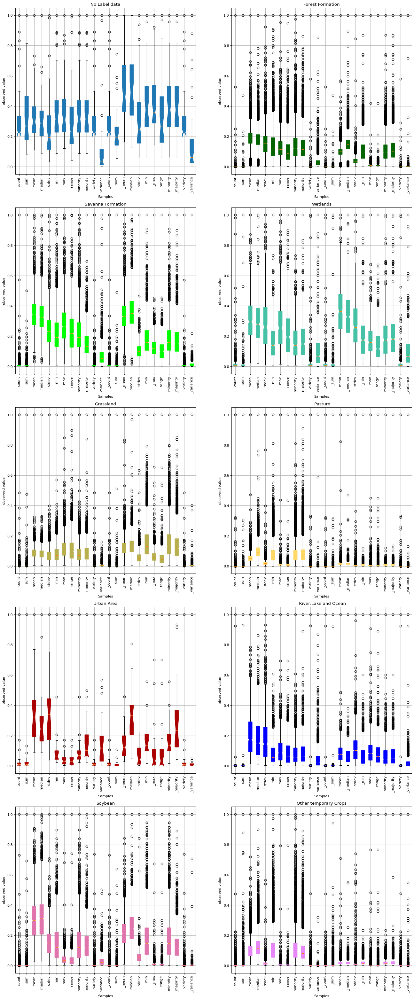

In [21]:
# S E N T I N E L - 1   D A T E - 1

figure(figsize=(20, 50), dpi=80)
#plt.suptitle("Classes distribuition for ")
for j in range(len(Sent1Outono_CLASSES)):
  plt.subplot(5,2,(j+1))
  data = Sent1Outono_CLASSES
  #Alocating coluns namnes in a vector 
  col_name = [] 
  for col in Sent1Outono.columns: col_name.append(col)
  #Alocating coluns in vector ⚠️ NORMALIZED ⚠️ ! Can I done these directily from pandas???
  all_data = []
  for i in range(2,len(col_name)): all_data.append(data[j][col_name[i]].values/max(data[j][col_name[i]].values)) 
  #Alocating Labels
  labels = []
  for i in range (2,len(col_name)): labels.append(col_name[i][14:])

  #Ploting boxplot
  plt.boxplot(all_data, vert=True, labels=labels, patch_artist=True, notch=True, 
              boxprops=dict(facecolor=colors[j], color=colors[j]))
  plt.ylabel('observed value')
  plt.xlabel('Samples')
  plt.title(titles_class[j])
  #plt.legend()
  plt.grid()
  plt.xticks(rotation=90)

plt.show()


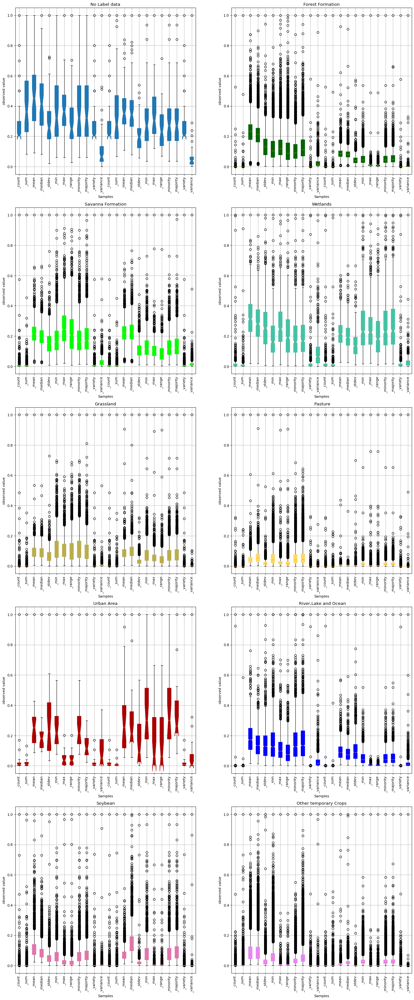

In [22]:
# S E N T I N E L - 1   D A T E - 2

figure(figsize=(20, 50), dpi=80)
#plt.suptitle("Classes distribuition for ")
for j in range(len(Sent1Primavera_CLASSES)):
  plt.subplot(5,2,(j+1))
  data = Sent1Primavera_CLASSES
  #Alocating coluns namnes in a vector 
  col_name = [] 
  for col in Sent1Primavera.columns: col_name.append(col) # NEED TO BE AJUDSTED
  #Alocating coluns in vector ⚠️ NORMALIZED ⚠️ ! Can I done these directily from pandas???
  all_data = []
  for i in range(2,len(col_name)): all_data.append(data[j][col_name[i]].values/max(data[j][col_name[i]].values)) 
  #Alocating Labels
  labels = []
  for i in range (2,len(col_name)): labels.append(col_name[i][14:])

  #Ploting boxplot
  plt.boxplot(all_data, vert=True, labels=labels, patch_artist=True, notch=True, 
              boxprops=dict(facecolor=colors[j], color=colors[j]))
  plt.ylabel('observed value')
  plt.xlabel('Samples')
  plt.title(titles_class[j])
  #plt.legend()
  plt.grid()
  plt.xticks(rotation=90)

plt.show()


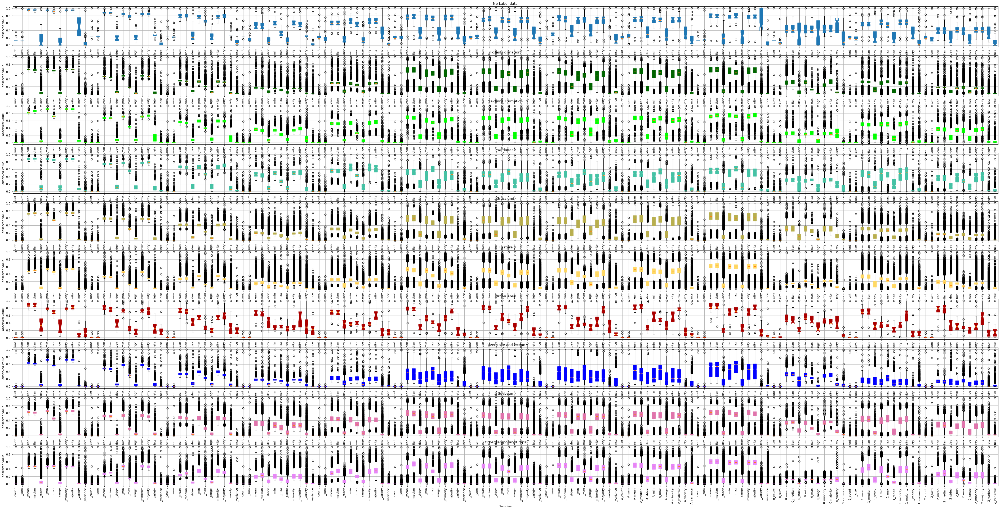

In [23]:
# S E N T I N E L - 2   D A T E - 1

figure(figsize=(60, 30), dpi=80)
#plt.suptitle("Classes distribuition for ")
for j in range(len(Sent2Outono_CLASSES)):
  plt.subplot(10,1,(j+1))
  data = Sent2Outono_CLASSES
  #Alocating coluns namnes in a vector 
  col_name = [] 
  for col in Sent2Outono.columns: col_name.append(col) # NEED TO BE AJUDSTED
  #Alocating coluns in vector ⚠️ NORMALIZED ⚠️ ! Can I done these directily from pandas???
  all_data = []
  for i in range(2,len(col_name)): all_data.append(data[j][col_name[i]].values/max(data[j][col_name[i]].values)) 
  #Alocating Labels
  labels = []
  for i in range (2,len(col_name)): labels.append(col_name[i][14:])

  #Ploting boxplot
  plt.boxplot(all_data, vert=True, labels=labels, patch_artist=True, notch=True, 
              boxprops=dict(facecolor=colors[j], color=colors[j]))
  plt.ylabel('observed value')
  plt.xlabel('Samples')
  plt.title(titles_class[j])
  #plt.legend()
  plt.grid()
  plt.xticks(rotation=90)

plt.show()


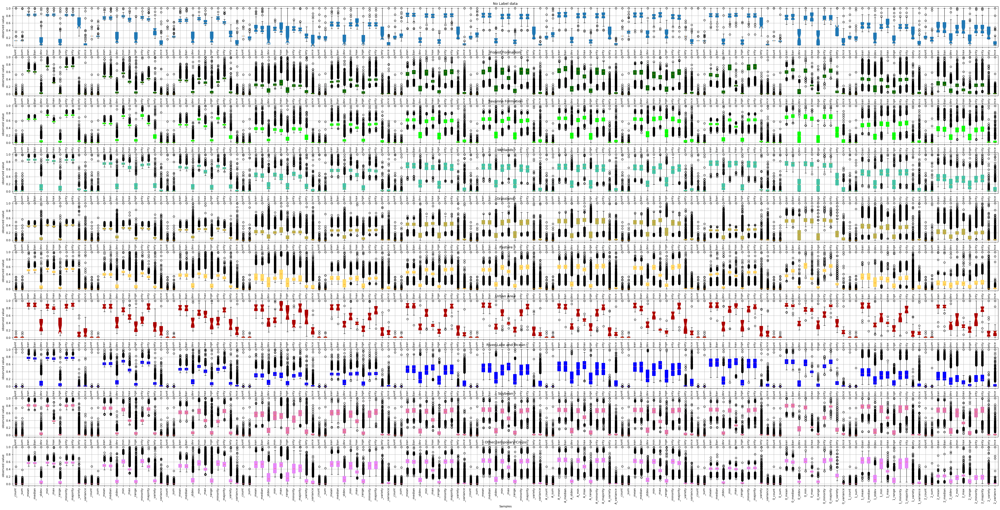

In [24]:
# S E N T I N E L - 2   D A T E - 1

figure(figsize=(60, 30), dpi=80)
#plt.suptitle("Classes distribuition for ")
for j in range(len(Sent2Primavera_CLASSES)):
  plt.subplot(10,1,(j+1))
  data = Sent2Primavera_CLASSES
  #Alocating coluns namnes in a vector 
  col_name = [] 
  for col in Sent2Primavera.columns: col_name.append(col) # NEED TO BE AJUDSTED
  #Alocating coluns in vector ⚠️ NORMALIZED ⚠️ ! Can I done these directily from pandas???
  all_data = []
  for i in range(2,len(col_name)): all_data.append(data[j][col_name[i]].values/max(data[j][col_name[i]].values)) 
  #Alocating Labels
  labels = []
  for i in range (2,len(col_name)): labels.append(col_name[i][14:])

  #Ploting boxplot
  plt.boxplot(all_data, vert=True, labels=labels, patch_artist=True, notch=True, 
              boxprops=dict(facecolor=colors[j], color=colors[j]))
  plt.ylabel('observed value')
  plt.xlabel('Samples')
  plt.title(titles_class[j])
  #plt.legend()
  plt.grid()
  plt.xticks(rotation=90)

plt.show()

## e) descreva e apresente possíveis correlações dos dados;

Podemos correlacionar os dados de cada um dos satélites. Aumentando assim a quantidade de informação que temos sobre cada segmentação. È interessante fazer isso juntando as colunas duplicando as informações referentes a aquela segmentação

**Dados de Outono**



In [25]:
GeoOutono = gpd.read_file('S120200528.gpkg')

In [26]:
classPalette = {
    0: 'C0',
    3: '#006400',
    4: '#00ff00',
    11: '#45C2A5',
    12: '#B8AF4F',
    15: '#FFD966',
    24: '#aa0000',
    33: '#0000FF',
    39: '#e075ad',
    41: '#e787f8'
}
classPalette

{0: 'C0',
 3: '#006400',
 4: '#00ff00',
 11: '#45C2A5',
 12: '#B8AF4F',
 15: '#FFD966',
 24: '#aa0000',
 33: '#0000FF',
 39: '#e075ad',
 41: '#e787f8'}

Imagem Segmentada da Região do Mato Grosso

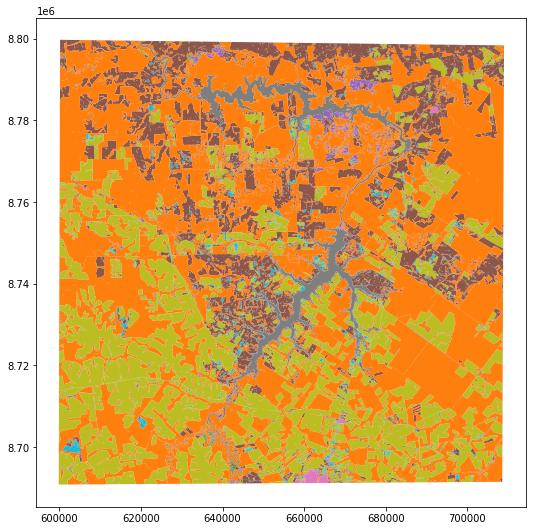

In [27]:
GeoOutono.plot(column='DN',categorical=True, figsize=(16,9))

In [28]:
#Agrupamento dos dados para facilitação das correlações internas e externas
group1_outono = Sent1Outono.groupby('DN')
group2_outono = Sent2Outono.groupby('DN')

Calculo das métricas estatísticas da polariação vertical e horizontal da área de estudo. Métricas dos valores médios e das medianas.

In [29]:
#Utilização das médias e medianas para descrição de comportamento geral das classes
#A partir do método `.describe` é possível obter as métricas estatísticas da coluna requerida
#Foram escolhidas inicialmente as colunas de valores médios e mediana, para ter se uma descrição geral, 
# no entanto as outras são igualmente importantes para o entendimento de correlação entre as classes
vhMean = group1_outono.describe()['S1_20200528_VHmean']
vvMean =  group1_outono.describe()['S1_20200528_VV_mean']

vhMedian = group1_outono.describe()['S1_20200528_VHmedian']
vvMedian =  group1_outono.describe()['S1_20200528_VV_median']

Calculo das métricas estatísticas das bandas espectrais que contém a resposta da refletancia da área de estudo. Métricas dos valores médios e das medianas.

In [30]:

b1Mean = group2_outono.describe()['20200531_S2_B1_mean']
b2Mean =  group2_outono.describe()['20200531_S2_B2_mean']
b3Mean =  group2_outono.describe()['20200531_S2_B3_mean']
b4Mean =  group2_outono.describe()['20200531_S2_B4_mean']
b5Mean =  group2_outono.describe()['20200531_S2_B5_mean']
b6Mean =  group2_outono.describe()['20200531_S2_B6_mean']
b7Mean =  group2_outono.describe()['20200531_S2_B7_mean']
b8Mean =  group2_outono.describe()['20200531_S2_B8_mean']
b8aMean =  group2_outono.describe()['20200531_S2_B8A_mean']
b9Mean =  group2_outono.describe()['20200531_S2_B9_mean']
b10Mean =  group2_outono.describe()['20200531_S2_B10_mean']
b11Mean =  group2_outono.describe()['20200531_S2_B11_mean']
b12Mean =  group2_outono.describe()['20200531_S2_B12_mean']

**Comportamento Espectral dos elementos terrestres**

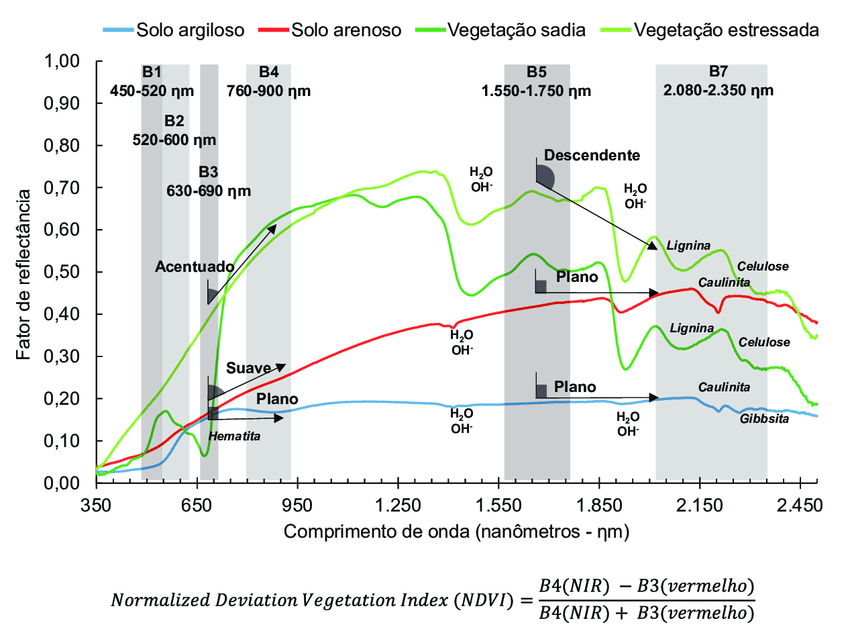

**Análise referente ao gráfico abaixo:**

Polarização Vertical-Vertical: As classes 3,4,11,12 e 15 que possuem vegetação natural apresentaram médias semelhantes entre 0.13 e 0.16. 
Já as classes que possuem algum tipo de lavroura se mostraram com a média em torno de 0.10 e a classe de área urbanizada se mostrou com a média muito alta comparada com as demais(em torno de 0.25). 
É possível observar também entre as classes 11 e 33 que a presença de água pode afetar (diminuir?) o valor dessa polarização.

Polarização Vertical-Horizontal: Os valores não se mostram discrepantes o suficiente para se chegar em alguma diferenciação entre as classes.



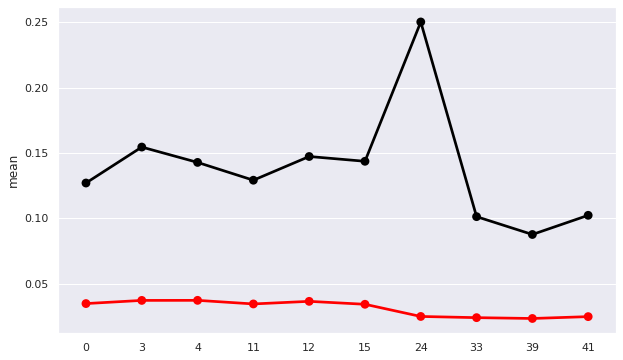

In [31]:

classes = [ 0,  3,  4, 11, 12, 15, 24, 33, 39, 41]
polarization = ['Vh', 'Vv']
sns.set(style="darkgrid")
plt.rcParams["figure.figsize"]=10,6

#Linha vermelha - Polarização vertical-horizontal
sns.pointplot(x=classes, y='mean', data=vhMean, color='red')
#Linha preta - Polarização vertical-vertical
sns.pointplot(x=classes, y='mean', data=vvMean, color='black')

**Análise referente ao gráfico abaixo:**

As Bandas abaixo possuem forte característica em relação aos elementos vegetativos e que possuem água. 
A Banda B8 é caracterizada pela alta refletividade de corpos vegetativos devido à estrutura destes, com isso é possível ver que as classes 3,4,12,15,39 e 41 possuem altos valores comparados aos demais. 
Já os corpos aquíferos possuem baixa refletancia considerando o exemplo anterior, isso devido à presença de água. No entanto é possível ver a classe 11 que possui presença de vegetação abaixo dágua mostra o comportamento dessa vegetação, estando com valor acima do corpo totalmente aquífero como a classe 33.
É possível ver tambem o aumento da energia refletida na área urbanizada em B2, B3 e B4, isso é devido aos elementos urbanos refletirem a luz do visivel com mais facilidade, não há tanta absorção com as outras classes

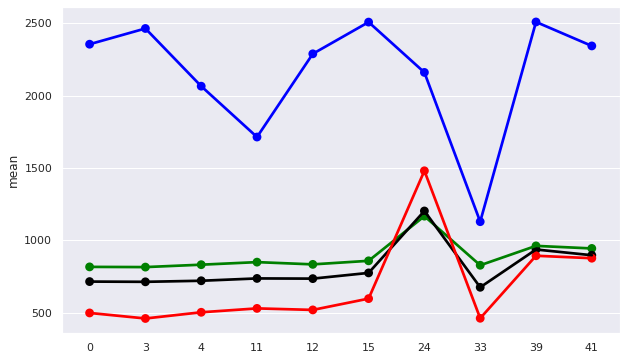

In [32]:
bands = ['b2', 'b3', 'b4', 'b8']
sns.set(style="darkgrid")
plt.rcParams["figure.figsize"]=10,6

#Linha verde - Banda B2
sns.pointplot(x=classes, y='mean', data=b2Mean, color='green')
#Linha verde - Banda B3
sns.pointplot(x=classes, y='mean', data=b3Mean, color='black')
#Linha vermelha - Banda B4
sns.pointplot(x=classes, y='mean', data=b4Mean, color='red')
#Linha azul - Banda B8
sns.pointplot(x=classes, y='mean', data=b8Mean, color='blue')

**Análise referente ao gráfico abaixo:**

As bandas abaixo são caracterizadas principalmente com a absorção de energia pela presença de água e isso se mostra marcante nas classes 11 e 33. 
As bandas B5 até 8a mostram o mesmo comportamento vegetativo anterior, pois possui comprimento de onda próximo aos descritos na banda 8. 
Nas lavrouras é possível ver alta refletancia e maior refletancia em b11 e b12.


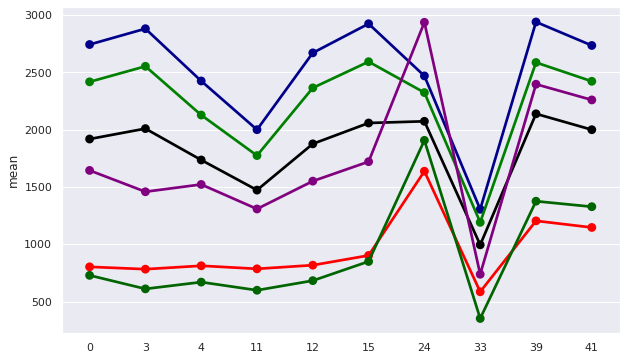

In [33]:
bands = ['b5', 'b6', 'b7', 'b8a', 'b11', 'b12']

#Linha vermelha - Banda B5
sns.pointplot(x=classes, y='mean', data=b5Mean, color='red')
#Linha preta - Banda B6
sns.pointplot(x=classes, y='mean', data=b6Mean, color='black')
#Linha verde - Banda B7
sns.pointplot(x=classes, y='mean', data=b7Mean, color='green')
#Linha azul - Banda B8a
sns.pointplot(x=classes, y='mean', data=b8aMean, color='darkblue')
#Linha roxo - Banda B11
sns.pointplot(x=classes, y='mean', data=b11Mean, color='purple')
#Linha verde escuro - Banda B12
sns.pointplot(x=classes, y='mean', data=b12Mean, color='darkgreen')

**Análise referente ao gráfico abaixo:**

O primeiro ponto a se observar é o alto pico na área urbanizada na banda B, isso ocorre devido à alta presença de aerossóis em regioes urbanizadas.
E nas classes 11 e 33 é possível ver novamente a absorção de água, características dos comprimentos de onda se B9 e B10. 

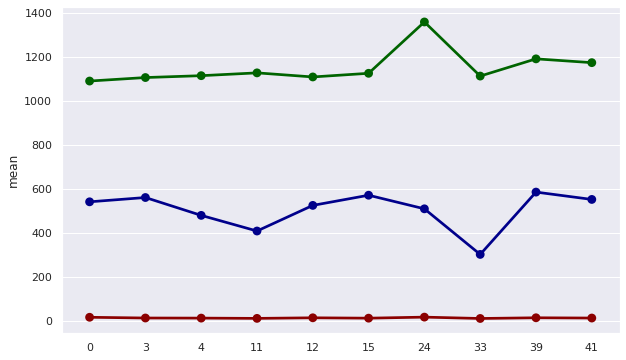

In [34]:
bands = ['b1', 'b9', 'b10']

#Linha verde - Banda B1
sns.pointplot(x=classes, y='mean', data=b1Mean, color='darkgreen')
#Linha verde - Banda B9
sns.pointplot(x=classes, y='mean', data=b9Mean, color='darkblue')
#Linha verde - Banda B10
sns.pointplot(x=classes, y='mean', data=b10Mean, color='darkred')

Agora iremos ver as correlações de dados dentro de cada classe. Por isso unimos os dataframes a partir de seu fid. 
As correlações possuem forte relacionamento com os hiperparâmetros que poderemos escolher nos procedimentos futuros, com isso foi visto a correlação dentro de cada classe e entre as classes. 

In [41]:
a = pd.merge(Sent1Outono, Sent2Outono, how='inner', on = 'fid')
group_a = a.groupby('DN_x')

**Análise referente ao gráfico abaixo:**

Na Classe 4 de Formação Savânica é possível ver alta correlação linear entre as bandas B2-B3, B2-B4, B2-B5, B12-B11, B8a-B8-B9.
Existem outras formações que parecem ser correlacionadas, no entanto seria necessário mais métodos estatísticos para identificar o tipo de correlação (função de correlação)

In [ ]:
a4 = group_a.get_group(4)
sns.pairplot(a4, hue='DN_x', palette=classPalette, vars=['S1_20200528_VV_mean', 'S1_20200528_VHmean','20200531_S2_B1_mean','20200531_S2_B2_mean','20200531_S2_B3_mean', '20200531_S2_B4_mean', '20200531_S2_B5_mean', '20200531_S2_B8_mean', '20200531_S2_B8A_mean', '20200531_S2_B9_mean', '20200531_S2_B10_mean', '20200531_S2_B11_mean', '20200531_S2_B12_mean' ])

KeyboardInterrupt: ignored

Error in callback <function flush_figures at 0x7f11e9414dd0> (for post_execute):


KeyboardInterrupt: ignored

**Análise referente ao gráfico abaixo:**

Na Classe 3 de Formação Florestal é possível ver alta correlação linear entre as bandas B2-B3, B2-B4, B2-B5, B12-B11, B8a-B8-B9.
Existem outras formações que parecem ser correlacionadas, no entanto seria necessário mais métodos estatísticos para identificar o tipo de correlação (função de correlação).
Aparentemente as correlações de VH e VV com os dados de bands tendenciam os dados aum ponto de origem, dependendo de qual eixo ele está, y=0 ou x=0

In [ ]:
a3 = group_a.get_group(3)
sns.pairplot(a3, hue='DN_x', palette=classPalette, vars=['S1_20200528_VV_mean', 'S1_20200528_VHmean','20200531_S2_B1_mean','20200531_S2_B2_mean','20200531_S2_B3_mean', '20200531_S2_B4_mean', '20200531_S2_B5_mean', '20200531_S2_B8_mean', '20200531_S2_B8A_mean', '20200531_S2_B9_mean', '20200531_S2_B10_mean', '20200531_S2_B11_mean', '20200531_S2_B12_mean' ])

**Análise referente ao gráfico abaixo:**

Na Classe 11 de Campo Alagado e Área Pantanosa é possível ver alta correlação linear entre as bandas B2-B3, B3-B4, B2-B4, B2-B5, B12-B11, B8a-B8-B9, B5-B12, B5-B11, B4-B12, B3-B11.
Existem outras formações que parecem ser correlacionadas, no entanto seria necessário mais métodos estatísticos para identificar o tipo de correlação (função de correlação)

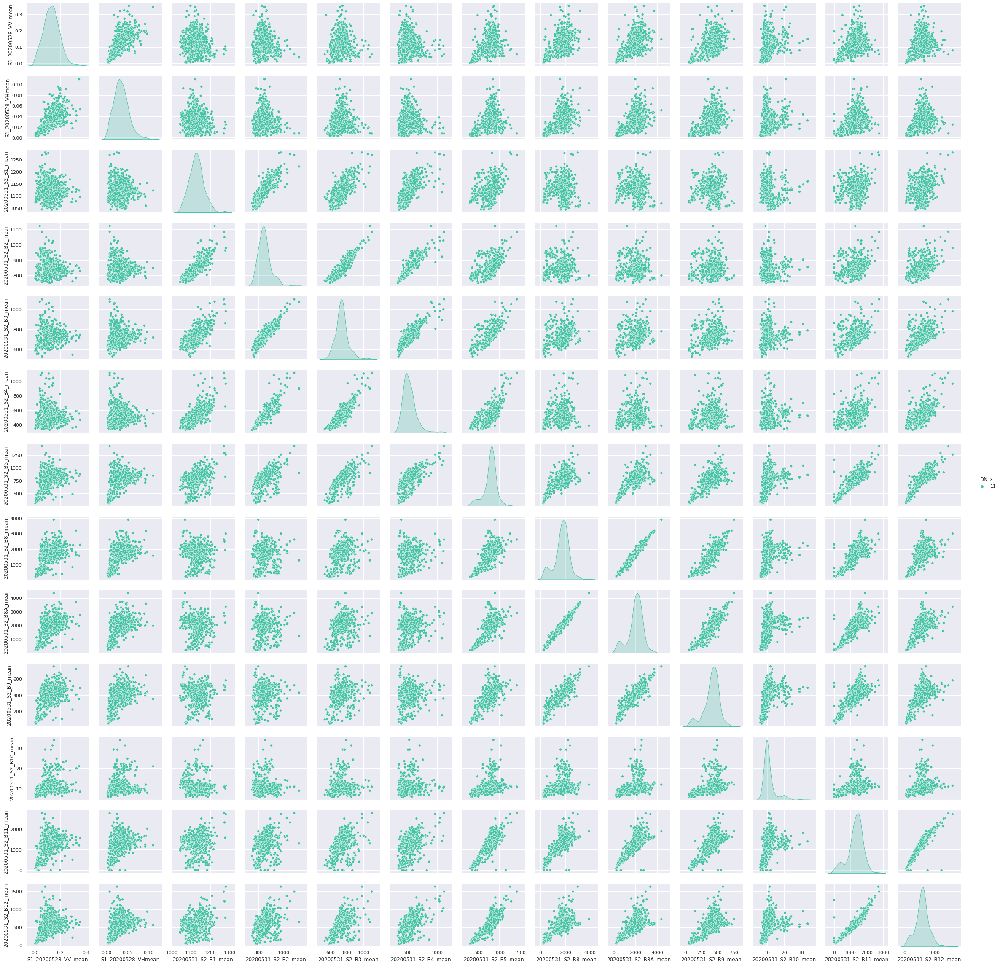

In [ ]:
a11 = group_a.get_group(11)
sns.pairplot(a11, hue='DN_x', palette=classPalette, vars=['S1_20200528_VV_mean', 'S1_20200528_VHmean','20200531_S2_B1_mean','20200531_S2_B2_mean','20200531_S2_B3_mean', '20200531_S2_B4_mean', '20200531_S2_B5_mean', '20200531_S2_B8_mean','20200531_S2_B8A_mean', '20200531_S2_B9_mean', '20200531_S2_B10_mean', '20200531_S2_B11_mean', '20200531_S2_B12_mean' ])

**Análise referente ao gráfico abaixo:**

Na Classe 11 de Campo Alagado e Área Pantanosa é possível ver alta correlação linear entre as bandas B2-B3, B3-B4, B2-B4, B2-B5, B12-B11, B8a-B8-B9, B5-B12, B5-B11, B4-B12, B3-B11.
Existem outras formações que parecem ser correlacionadas, no entanto seria necessário mais métodos estatísticos para identificar o tipo de correlação (função de correlação)
Aparentemente as correlações de VH e VV com os dados de bands tendenciam os dados aum ponto de origem, dependendo de qual eixo ele está, y=0 ou x=0

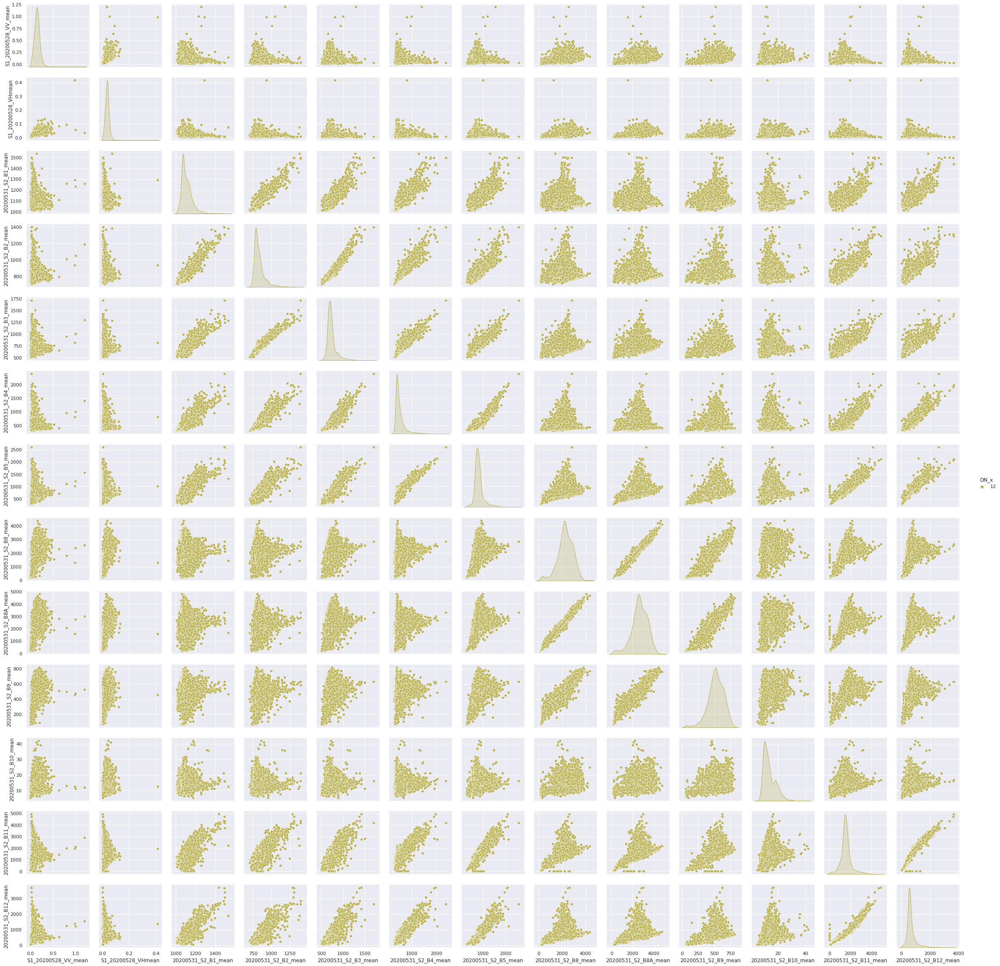

In [ ]:
a12 = group_a.get_group(12)
sns.pairplot(a12, hue='DN_x', palette=classPalette, vars=['S1_20200528_VV_mean', 'S1_20200528_VHmean','20200531_S2_B1_mean','20200531_S2_B2_mean','20200531_S2_B3_mean', '20200531_S2_B4_mean', '20200531_S2_B5_mean', '20200531_S2_B8_mean', '20200531_S2_B8A_mean', '20200531_S2_B9_mean', '20200531_S2_B10_mean', '20200531_S2_B11_mean', '20200531_S2_B12_mean' ])

**Análise referente ao gráfico abaixo:**

Na Classe 15 de Pastagem é possível ver alta correlação linear entre as bandas B2-B3, B3-B4, B2-B4, B2-B5, B3-B5, B4-B5, B12-B11, B8a-B8-B9, B5-B12, B5-B11, B4-B12, B3-B11.
Existem outras formações que parecem ser correlacionadas, no entanto seria necessário mais métodos estatísticos para identificar o tipo de correlação (função de correlação)
Aparentemente as correlações de VH e VV com os dados de bands tendenciam os dados aum ponto de origem, dependendo de qual eixo ele está, y=0 ou x=0

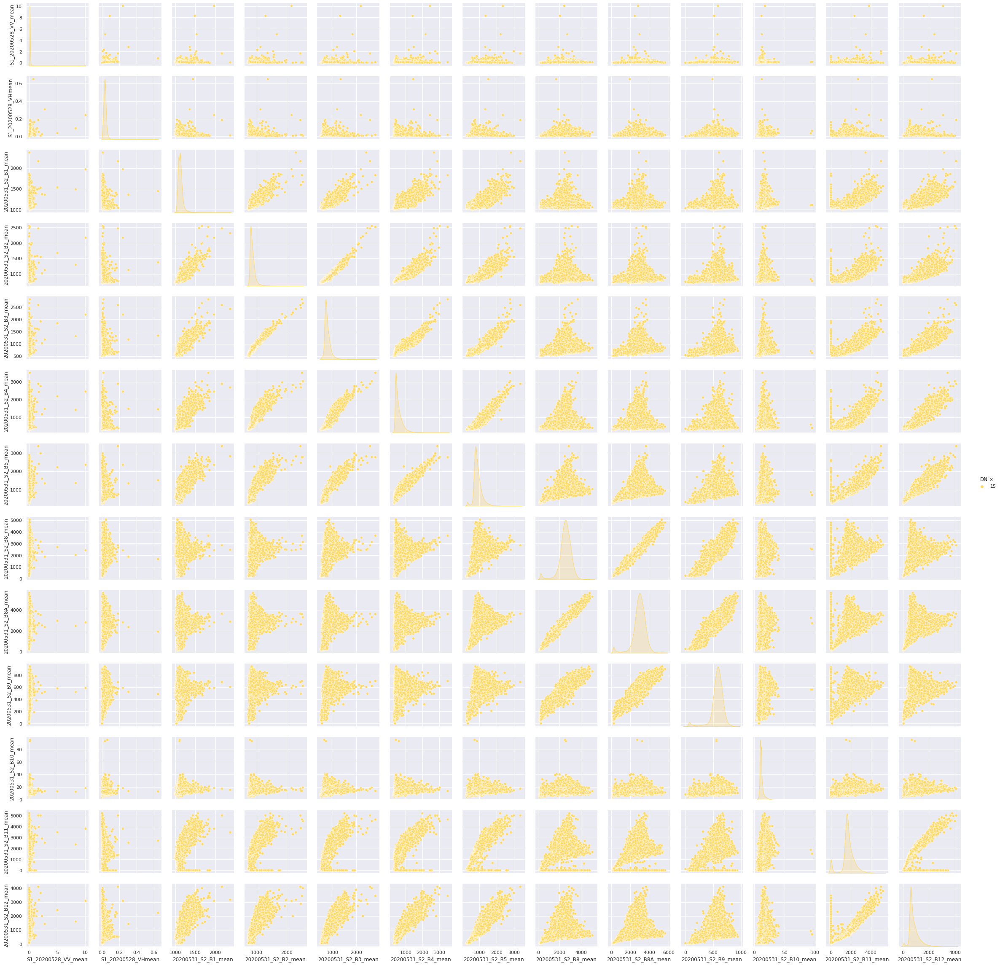

In [ ]:
a15 = group_a.get_group(15)
sns.pairplot(a15, hue='DN_x', palette=classPalette, vars=['S1_20200528_VV_mean', 'S1_20200528_VHmean','20200531_S2_B1_mean','20200531_S2_B2_mean','20200531_S2_B3_mean', '20200531_S2_B4_mean', '20200531_S2_B5_mean', '20200531_S2_B8_mean', '20200531_S2_B8A_mean', '20200531_S2_B9_mean', '20200531_S2_B10_mean', '20200531_S2_B11_mean', '20200531_S2_B12_mean' ])

**Análise referente ao gráfico abaixo:**

Na Classe 24 de Área Urbanizada é possível ver alta correlação linear entre as bandas B1-B2, B2-B3, B4-B5, B6-B7, B5-B6.
Existem outras formações que parecem ser correlacionadas, no entanto seria necessário mais métodos estatísticos para identificar o tipo de correlação (função de correlação)

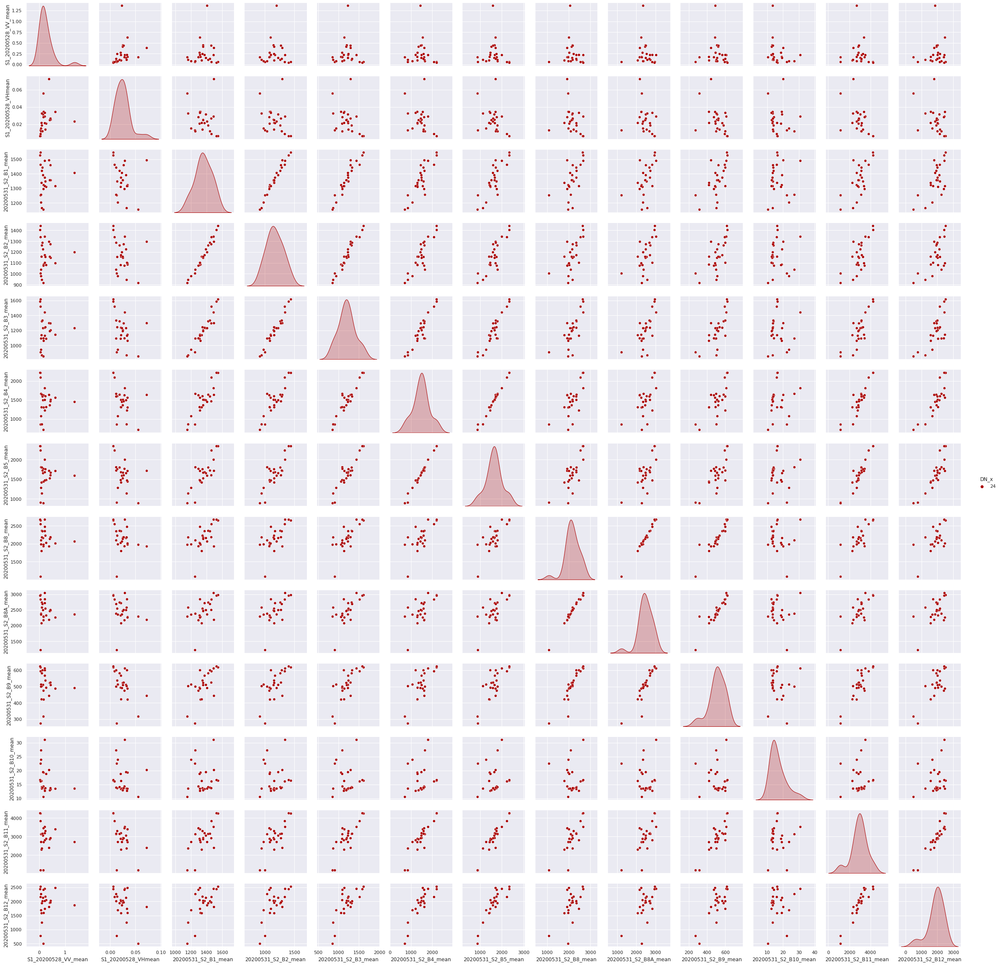

In [ ]:
a24 = group_a.get_group(24)
sns.pairplot(a24, hue='DN_x', palette=classPalette, vars=['S1_20200528_VV_mean', 'S1_20200528_VHmean','20200531_S2_B1_mean','20200531_S2_B2_mean','20200531_S2_B3_mean', '20200531_S2_B4_mean', '20200531_S2_B5_mean', '20200531_S2_B8_mean', '20200531_S2_B8A_mean', '20200531_S2_B9_mean', '20200531_S2_B10_mean', '20200531_S2_B11_mean', '20200531_S2_B12_mean' ])

**Análise referente ao gráfico abaixo:**

Na Classe 33 de Rio, lago e Oceano é possível ver alta correlação linear entre as bandas B2-B3, B3-B4, B2-B4, B2-B5, B12-B11, B8a-B8-B9.
Existem outras formações que parecem ser correlacionadas, no entanto seria necessário mais métodos estatísticos para identificar o tipo de correlação (função de correlação)

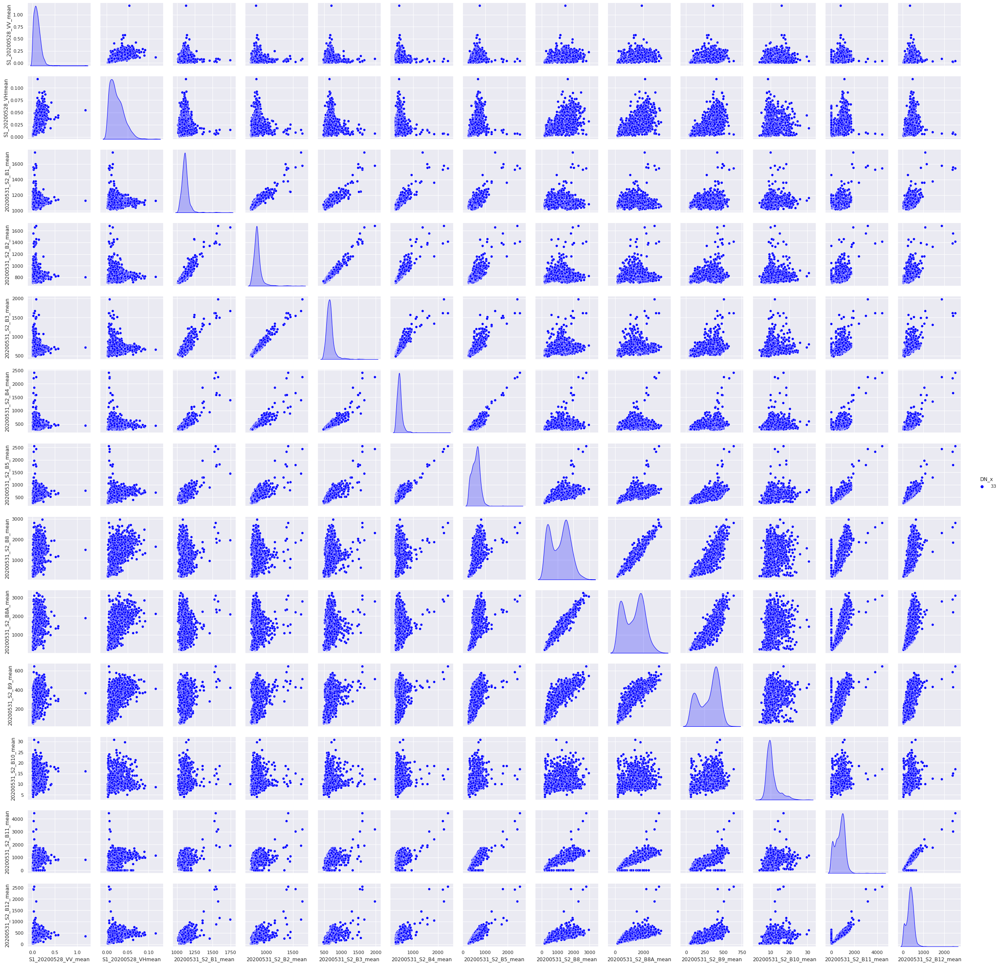

In [ ]:
a33 = group_a.get_group(33)
sns.pairplot(a33, hue='DN_x', palette=classPalette, vars=['S1_20200528_VV_mean', 'S1_20200528_VHmean','20200531_S2_B1_mean','20200531_S2_B2_mean','20200531_S2_B3_mean', '20200531_S2_B4_mean', '20200531_S2_B5_mean', '20200531_S2_B8_mean', '20200531_S2_B8A_mean', '20200531_S2_B9_mean', '20200531_S2_B10_mean', '20200531_S2_B11_mean', '20200531_S2_B12_mean' ])


Na Classe 39 de Soja é possível ver alta correlação linear entre as bandas B2-B3, B3-B4, B2-B4, B2-B5, B3-B5, B4-B5, B12-B11, B8a-B8-B9, B5-B12, B5-B11, B4-B12, B3-B11.
Existem outras formações que parecem ser correlacionadas, no entanto seria necessário mais métodos estatísticos para identificar o tipo de correlação (função de correlação)

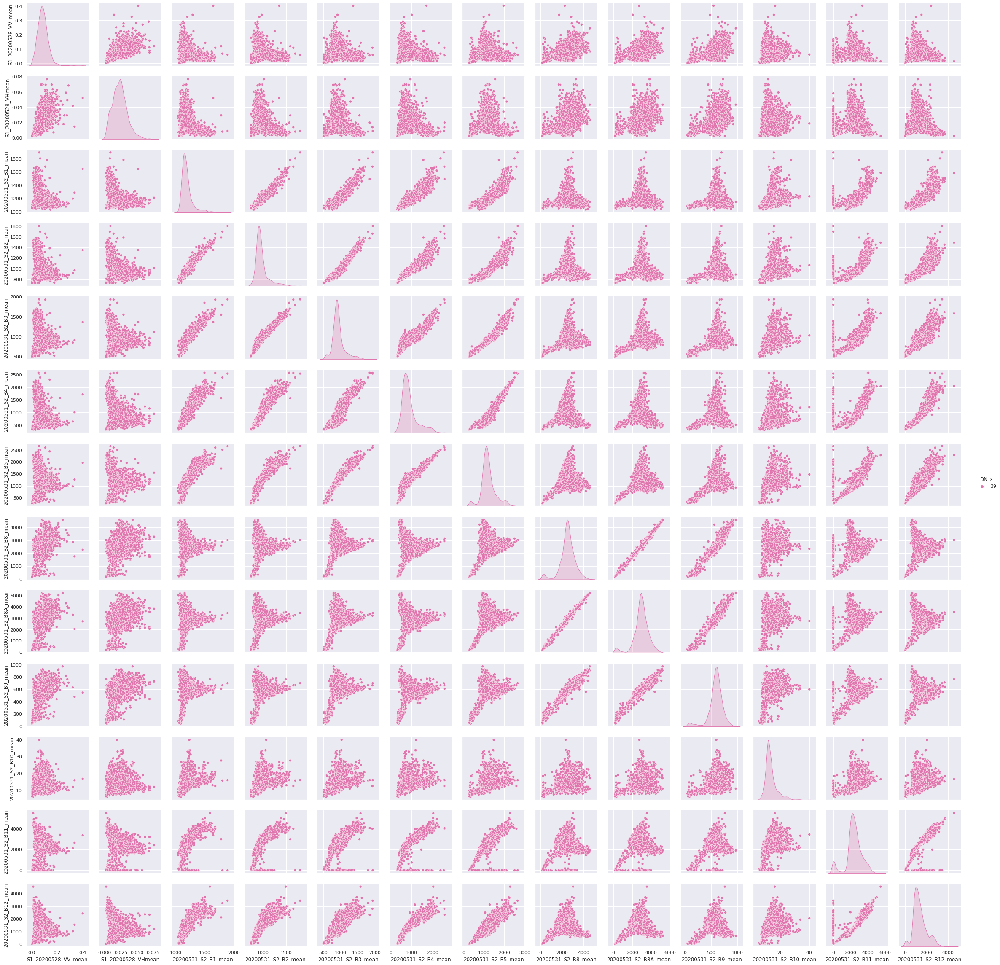

In [ ]:
a39 = group_a.get_group(39)
sns.pairplot(a39, hue='DN_x', palette=classPalette, vars=['S1_20200528_VV_mean', 'S1_20200528_VHmean','20200531_S2_B1_mean','20200531_S2_B2_mean','20200531_S2_B3_mean', '20200531_S2_B4_mean', '20200531_S2_B5_mean', '20200531_S2_B8_mean', '20200531_S2_B8A_mean', '20200531_S2_B9_mean', '20200531_S2_B10_mean', '20200531_S2_B11_mean', '20200531_S2_B12_mean' ])


Na Classe 41 de Outras Lavrouras Temporarias é possível ver alta correlação linear entre as bandas B2-B3, B3-B4, B2-B4, B2-B5, B3-B5, B4-B5, B12-B11, B8a-B8-B9, B5-B12, B5-B11, B4-B12, B3-B11.
Existem outras formações que parecem ser correlacionadas, no entanto seria necessário mais métodos estatísticos para identificar o tipo de correlação (função de correlação)
Aparentemente as correlações de VH e VV com os dados de bands tendenciam os dados aum ponto de origem, dependendo de qual eixo ele está, y=0 ou x=0

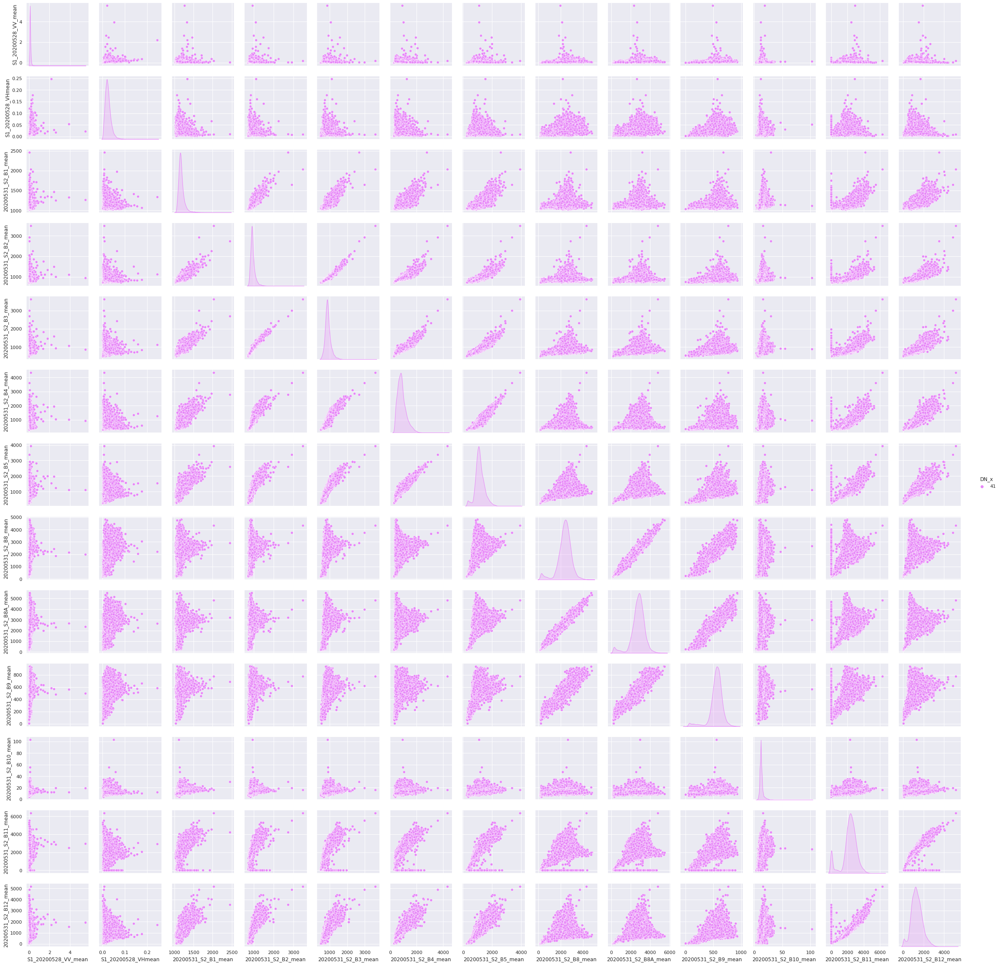

In [ ]:
a41 = group_a.get_group(41)
sns.pairplot(a41, hue='DN_x', palette=classPalette, vars=['S1_20200528_VV_mean', 'S1_20200528_VHmean','20200531_S2_B1_mean','20200531_S2_B2_mean','20200531_S2_B3_mean', '20200531_S2_B4_mean', '20200531_S2_B5_mean', '20200531_S2_B8_mean', '20200531_S2_B8A_mean', '20200531_S2_B9_mean', '20200531_S2_B10_mean', '20200531_S2_B11_mean', '20200531_S2_B12_mean' ])

In [ ]:
print('A quantidade de dados da classe 0 é (x,y) =',group_a.get_group(0).shape)
print('A quantidade de dados da classe de Formação Florestal é (x,y) =',group_a.get_group(3).shape)
print('A quantidade de dados da classe de Formação Savânica é (x,y) =',group_a.get_group(4).shape)
print('A quantidade de dados da classe de Campo alagado e área pantanosa é (x,y) =',group_a.get_group(11).shape)
print('A quantidade de dados da classe de Formação Campestre é (x,y) =',group_a.get_group(12).shape)
print('A quantidade de dados da classe de Pastagem é (x,y) =',group_a.get_group(15).shape)
print('A quantidade de dados da classe de Área Urbanizada é (x,y) =',group_a.get_group(24).shape)
print('A quantidade de dados da classe de Rio, lago e oceano é (x,y) =',group_a.get_group(33).shape)
print('A quantidade de dados da classe de Soja é (x,y) =',group_a.get_group(39).shape)
print('A quantidade de dados da classe de Outras lavrouras temporárias é (x,y) =',group_a.get_group(41).shape)

A quantidade de dados da classe 0 é (x,y) = (54, 183)
A quantidade de dados da classe de Formação Florestal é (x,y) = (10026, 183)
A quantidade de dados da classe de Formação Savânica é (x,y) = (2017, 183)
A quantidade de dados da classe de Campo alagado e área pantanosa é (x,y) = (608, 183)
A quantidade de dados da classe de Formação Campestre é (x,y) = (4892, 183)
A quantidade de dados da classe de Pastagem é (x,y) = (42456, 183)
A quantidade de dados da classe de Área Urbanizada é (x,y) = (25, 183)
A quantidade de dados da classe de Rio, lago e oceano é (x,y) = (1680, 183)
A quantidade de dados da classe de Soja é (x,y) = (2838, 183)
A quantidade de dados da classe de Outras lavrouras temporárias é (x,y) = (25445, 183)


Na Correlação entre todas as classes é possível ver alta correlação linear entre as bandas B2-B3, B3-B4, B2-B4, B2-B5, B3-B5, B4-B5, B12-B11, B8a-B8-B9, B5-B12, B5-B11, B4-B12, B3-B11. Existem outras formações que parecem ser correlacionadas, no entanto seria necessário mais métodos estatísticos para identificar o tipo de correlação (função de correlação) Aparentemente as correlações de VH e VV com os dados de bands tendenciam os dados a um ponto de origem, dependendo de qual eixo ele está, y=0 ou x=0

In [ ]:
sns.pairplot(a, hue='DN_x', palette=classPalette, vars=['S1_20200528_VV_mean', 'S1_20200528_VHmean','20200531_S2_B1_mean','20200531_S2_B2_mean','20200531_S2_B3_mean', '20200531_S2_B4_mean', '20200531_S2_B5_mean', '20200531_S2_B8_mean', '20200531_S2_B8A_mean', '20200531_S2_B9_mean', '20200531_S2_B10_mean', '20200531_S2_B11_mean', '20200531_S2_B12_mean' ])

Error in callback <function flush_figures at 0x7f33e15e3dd0> (for post_execute):


KeyboardInterrupt: ignored

União dos dataframes para normalização e utilização em modelos de aprendizagem. 

**Dados de Primavera**

In [35]:
#Agrupamento dos dados para facilitação das correlações internas e externas
group1_primavera = Sent1Primavera.groupby('DN')
group2_primavera = Sent2Primavera.groupby('DN')

In [36]:
group2_primavera.get_group(3)

,fid,DN,20201008_S2_B1_count,20201008_S2_B1_sum,20201008_S2_B1_mean,20201008_S2_B1_median,20201008_S2_B1_stdev,20201008_S2_B1_min,20201008_S2_B1_max,20201008_S2_B1_range,...,20201008_S2_B12_mean,20201008_S2_B12_median,20201008_S2_B12_stdev,20201008_S2_B12_min,20201008_S2_B12_max,20201008_S2_B12_range,20201008_S2_B12_minority,20201008_S2_B12_majority,20201008_S2_B12_variety,20201008_S2_B12_variance
2,1274,3,3.000000,4.252000e+03,1417.333333,1418.0,1.699673,1415.0,1419.0,4.0,...,1221.187500,1199.5,105.117327,1099.0,1473.0,374.0,1099.0,1099.0,16.0,11049.652344
7,1291,3,0.975540,1.379750e+03,1414.344665,1411.5,3.263861,1410.0,1417.0,7.0,...,1225.555556,1236.0,79.880621,1059.0,1319.0,260.0,1059.0,1059.0,9.0,6380.913580
11,1309,3,5.000000,7.122000e+03,1424.400000,1419.0,23.837785,1398.0,1468.0,70.0,...,1073.023256,942.0,298.122223,739.0,1695.0,956.0,739.0,1337.0,42.0,88876.859924
14,1313,3,3.000000,4.265000e+03,1421.666667,1414.0,11.556624,1413.0,1438.0,25.0,...,823.028571,766.0,180.349262,662.0,1449.0,787.0,662.0,669.0,33.0,32525.856327
16,1322,3,1.254242,1.768569e+03,1410.070059,1416.5,19.911233,1398.0,1452.0,54.0,...,996.181818,924.0,155.950935,851.0,1393.0,542.0,851.0,851.0,11.0,24320.694215
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
90031,98100,3,10862.000000,1.538547e+07,1416.449365,1408.0,65.447318,1308.0,1840.0,532.0,...,614.528654,589.0,164.993703,414.0,3407.0,2993.0,414.0,577.0,1603.0,27222.922112
90035,98149,3,624.000000,8.805370e+05,1411.116987,1417.0,46.304290,1342.0,1619.0,277.0,...,805.650096,695.0,425.162229,314.0,3221.0,2907.0,314.0,652.0,851.0,180762.920977
90036,98158,3,83148.000000,1.135369e+08,1365.480096,1349.0,57.032960,1278.0,1750.0,472.0,...,651.539819,608.0,226.934477,132.0,3543.0,3411.0,132.0,588.0,3042.0,51499.257062
90038,98176,3,2587.000000,3.688141e+06,1425.643989,1420.0,23.180783,1383.0,1597.0,214.0,...,626.942461,590.0,212.088514,402.0,2984.0,2582.0,402.0,588.0,1040.0,44981.537880


In [ ]:
#Utilização das médias e medianas para descrição de comportamento geral das classes
#A partir do método `.describe` é possível obter as métricas estatísticas da coluna requerida
#Foram escolhidas inicialmente as colunas de valores médios e mediana, para ter se uma descrição geral, 
# no entanto as outras são igualmente importantes para o entendimento de correlação entre as classes
vhMeanP = group1_primavera.describe()['20201007_S1_VH_mean']
vvMeanP =  group1_primavera.describe()['20201007_S1_VV_mean']

vhMedianP = group1_primavera.describe()['20201007_S1_VH_median']
vvMedianP =  group1_primavera.describe()['20201007_S1_VV_mean']

In [ ]:
b1MeanP = group2_primavera.describe()['20201008_S2_B1_mean']
b2MeanP =  group2_primavera.describe()['20201008_S2_B2_mean']
b3MeanP =  group2_primavera.describe()['20201008_S2_B3_mean']
b4MeanP =  group2_primavera.describe()['20201008_S2_B4_mean']
b5MeanP =  group2_primavera.describe()['20201008_S2_B5_mean']
b6MeanP =  group2_primavera.describe()['20201008_S2_B6_mean']
b7MeanP =  group2_primavera.describe()['20201008_S2_B7_mean']
b8MeanP =  group2_primavera.describe()['20201008_S2_B8_mean']
b8aMeanP =  group2_primavera.describe()['20201008_S2_B8A_mean']
b9MeanP =  group2_primavera.describe()['20201008_S2_B9_mean']
b10MeanP =  group2_primavera.describe()['20201008_S2_B10_mean']
b11MeanP =  group2_primavera.describe()['20201008_S2_B11_mean']
b12MeanP =  group2_primavera.describe()['20201008_S2_B12_mean']

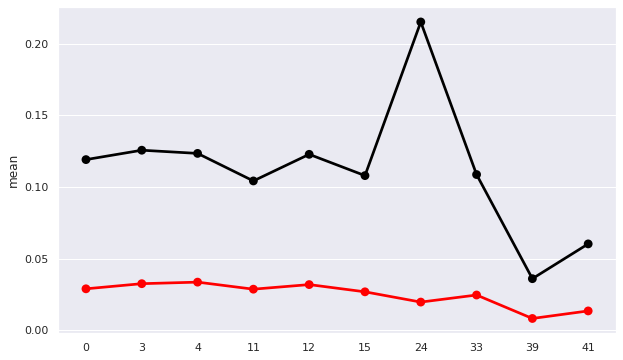

In [ ]:
classes = [ 0,  3,  4, 11, 12, 15, 24, 33, 39, 41]
polarization = ['Vh', 'Vv']
sns.set(style="darkgrid")
plt.rcParams["figure.figsize"]=10,6

#Linha vermelha - Polarização vertical-horizontal
sns.pointplot(x=classes, y='mean', data=vhMeanP, color='red')
#Linha preta - Polarização vertical-vertical
sns.pointplot(x=classes, y='mean', data=vvMeanP, color='black')

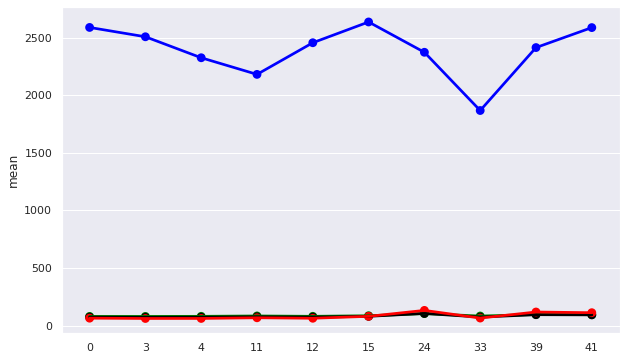

In [ ]:
bands = ['b2', 'b3', 'b4', 'b8']
sns.set(style="darkgrid")
plt.rcParams["figure.figsize"]=10,6

#Linha verde - Banda B2
sns.pointplot(x=classes, y='mean', data=b2MeanP, color='green')
#Linha verde - Banda B3
sns.pointplot(x=classes, y='mean', data=b3MeanP, color='black')
#Linha vermelha - Banda B4
sns.pointplot(x=classes, y='mean', data=b4MeanP, color='red')
#Linha azul - Banda B8
sns.pointplot(x=classes, y='mean', data=b8MeanP, color='blue')

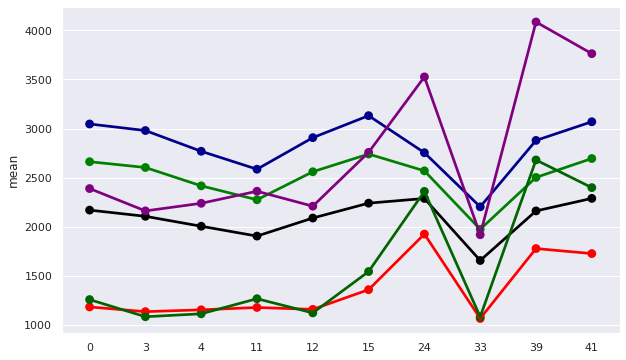

In [ ]:
bands = ['b5', 'b6', 'b7', 'b8a', 'b11', 'b12']

#Linha vermelha - Banda B5
sns.pointplot(x=classes, y='mean', data=b5MeanP, color='red')
#Linha preta - Banda B6
sns.pointplot(x=classes, y='mean', data=b6MeanP, color='black')
#Linha verde - Banda B7
sns.pointplot(x=classes, y='mean', data=b7MeanP, color='green')
#Linha azul - Banda B8a
sns.pointplot(x=classes, y='mean', data=b8aMeanP, color='darkblue')
#Linha roxo - Banda B11
sns.pointplot(x=classes, y='mean', data=b11MeanP, color='purple')
#Linha verde escuro - Banda B12
sns.pointplot(x=classes, y='mean', data=b12MeanP, color='darkgreen')

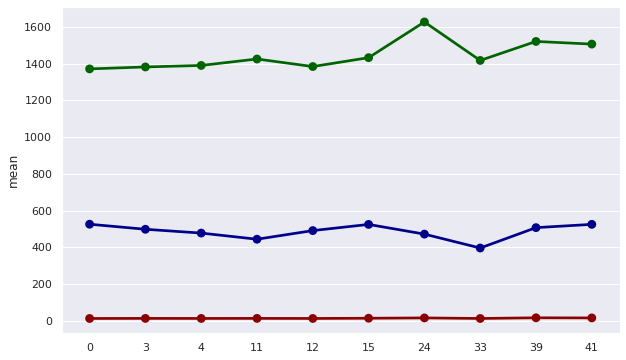

In [ ]:
bands = ['b1', 'b9', 'b10']

#Linha verde - Banda B1
sns.pointplot(x=classes, y='mean', data=b1MeanP, color='darkgreen')
#Linha verde - Banda B9
sns.pointplot(x=classes, y='mean', data=b9MeanP, color='darkblue')
#Linha verde - Banda B10
sns.pointplot(x=classes, y='mean', data=b10MeanP, color='darkred')

União dos dados para utilização no modelos de aprendizagem de máquina

In [37]:
#União de dados da Primavera e Agrupamento por classes- Data 2
b = pd.merge(Sent1Primavera, Sent2Primavera, how='inner', on = 'fid')
group_b = b.groupby('DN_x')

In [38]:
#Drop das linhas que possuem valores nulos - Primavera
Sent12Primavera = b
Sent12Primavera.dropna(inplace=True)
Sent12Primavera.reset_index(inplace=True, drop=True)
Sent12Primavera.shape

(90041, 183)

In [39]:
Sent12Primavera = Sent12Primavera.drop(Sent12Primavera.index[[0,1]])

In [42]:
#Drop das linhas que possuem valores nulos - Outono
Sent12Outono = a
Sent12Outono.dropna(inplace=True)
Sent12Outono.reset_index(inplace=True, drop=True)
Sent12Outono.shape

(90041, 183)

In [43]:
Sent12Outono = Sent12Outono.drop(Sent12Outono.index[[0,1]])

# **Atividade 02**

Após a conclusão da atividade 1, vocês têm entendimento do problema a ser resolvido. (https://drive.google.com/file/d/1OzCFj26aTVmw-dEAGhAhTbv2kFO2K7YD/view?usp=sharing). Além disso, estão com os 
dados analisados e tratados. 

Na atividade 2, daremos início ao emprego de técnicas de aprendizagem de máquina para solução do problema proposto.

1) Considere os mesmos dados disponibilizados na atividade 1: https://drive.google.com/drive/folders/1jLUUUl-KcNOaDWGRkivA6C5g-gE7FZUd?usp=sharing 

Conjunto 1 – 1o período: 
   a) Sentinel 1. Data: 28-05-2022 
   b) Sentinel 2. Data: 31-05-2022 

Conjunto 2 – 2o período: 
   a) Sentinel 1. Data: 07-10-2022 
   b) Sentinel 2. Data: 08-10-2022 



2) Considere o exemplo do uso de uma rede neural artificial de múltiplas camadas para solução do problema, disponível em: https://colab.research.google.com/drive/1tYWcdMF_uJXdT2ZGrVE-Exj0oDICnSfE?usp=sharing



3) Utilize técnicas de aprendizagem de máquina para classificar os dados analisados e tratados na atividade 1.

4) Apresente a estratégia de separação dos conjuntos utilizada na sua solução. Evidencie como é formado o conjunto de teste.
5) Varie os hiper-parâmetros das técnicas, visando-se melhorar a capacidade de generalização. Apresente os resultados destes ajustes em tabelas.
6) Caso julgue necessário, combine os dados do conjunto 1. Os dados do conjunto 2 também podem ser combinados. Apresente os resultados em tabelas.

O trabalho pode ser feito em grupo de até 3 pessoas. 

Apresente a atividade 2 no mesmo documento da atividade 1, formato (IEEE) (https://www.ieee.org/conferences/publishing/templates.html). 


Cada um deve postar a atividade (arquivos .pdf e programas), com indicação da composição do grupo.


Prazo para postagem: 29/04/2022

Importando Bibliotecas de Aprendizado de Máquina




In [44]:
from sklearn.preprocessing import StandardScaler
from sklearn.neural_network import MLPClassifier
from sklearn import svm
from sklearn import metrics
from sklearn.metrics import classification_report, confusion_matrix
from sklearn.model_selection import train_test_split

*** Aplicação do modelo SVM - Support Vector Machine nos dados***

Foram escolhidos 70% dos dados para treinamento e 30% para teste.
y_treino corresponde às classes e x_treino corresponde aos dados de bandas e polarizações. 

In [70]:
y_treino = np.array(Sent12Outono[Sent12Outono.columns[1]])
x_treino = np.array(Sent12Outono[Sent12Outono.columns[2:183]])
X_train, X_test, y_train, y_test = train_test_split(x_treino, y_treino, test_size=0.3,random_state=109)


In [46]:
#Create a svm Classifier
clf = svm.LinearSVC() # Linear Kernel

#Train the model using the training sets
clf.fit(X_train, y_train)


/usr/local/lib/python3.7/dist-packages/sklearn/svm/_base.py:1208: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  ConvergenceWarning,


LinearSVC()

In [48]:
#Predict the response for test dataset
y_pred = clf.predict(X_test)
y_pred

array([15, 41, 41, ..., 15, 15, 39])

Métricas de Qualidade do Modelo de Aprendizagem de Máquina Support Vector Machine

In [49]:
print("Accuracy:",metrics.accuracy_score(y_test, y_pred))

Accuracy: 0.5640085887753591


In [50]:
print(confusion_matrix(y_test, y_pred))
print(classification_report(y_test, y_pred))

[[   0    1    0    0    0   12    0    0    0    0]
 [   5  248    4   12    0 2602    0    0  125   14]
 [   1   39    3    6    0  564    0    0   10    4]
 [   2   31    1    4    0  112    0    0   23   10]
 [   7  133    5   15    0 1091    1    0  185   86]
 [ 322 1038   62  287    0 8348    0    1  884 1659]
 [   0    0    0    0    0    2    0    0    0    6]
 [   0   29    4    1    0   14    0    2  104  340]
 [   1    6    1    2    0  300    0    0   16  537]
 [  60   91   16   39    0  575    0    0  295 6614]]
              precision    recall  f1-score   support

           0       0.00      0.00      0.00        13
           3       0.15      0.08      0.11      3010
           4       0.03      0.00      0.01       627
          11       0.01      0.02      0.01       183
          12       0.00      0.00      0.00      1523
          15       0.61      0.66      0.64     12601
          24       0.00      0.00      0.00         8
          33       0.67      0.00   

/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


In [ ]:
print("Recall:",metrics.recall_score(y_test, y_pred))

Testando outros hiperparâmetros

In [51]:
#Create a svm Classifier
clf = svm.LinearSVC(max_iter=3000) # Linear Kernel

#Train the model using the training sets
clf.fit(X_train, y_train)
#Predict the response for test dataset
y_pred = clf.predict(X_test)
print(y_pred)

print("Accuracy:",metrics.accuracy_score(y_test, y_pred))
print(confusion_matrix(y_test, y_pred))
print(classification_report(y_test, y_pred))

[15 41 41 ... 15 41 41]
Accuracy: 0.6120242855027396
[[    0     0     0     0     0    13     0     0     0     0]
 [    1   191     1    16    24  2172     0     2    36   567]
 [    0    89     0    23    48   441     0     0     3    23]
 [    0     8     1     6    18   138     0     0     7     5]
 [    1    34     5    42    97  1101     0     5    35   203]
 [    1    28     5    48   279 10044     0     7    63  2126]
 [    0     0     0     0     6     2     0     0     0     0]
 [    0     0     0    21    54    87     1    91    47   193]
 [    0     0     0     5    99    19     0     4    11   725]
 [    3     0     0    33   331  1140     2    23    66  6092]]
              precision    recall  f1-score   support

           0       0.00      0.00      0.00        13
           3       0.55      0.06      0.11      3010
           4       0.00      0.00      0.00       627
          11       0.03      0.03      0.03       183
          12       0.10      0.06      0.08  

/usr/local/lib/python3.7/dist-packages/sklearn/svm/_base.py:1208: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  ConvergenceWarning,


In [53]:
#Create a svm Classifier
clf = svm.LinearSVC(loss='hinge',max_iter=1000) # Linear Kernel

#Train the model using the training sets
clf.fit(X_train, y_train)
#Predict the response for test dataset
y_pred = clf.predict(X_test)
print(y_pred)

print("Accuracy:",metrics.accuracy_score(y_test, y_pred))
print(confusion_matrix(y_test, y_pred))
print(classification_report(y_test, y_pred))

[15 15 41 ... 15 15 15]
Accuracy: 0.5103287427809863
[[    0     0     0     0     0    13     0     0     0     0]
 [    0     3     0     0     0  2993     0     0     3    11]
 [    0     1     0     0     0   626     0     0     0     0]
 [    0     0     0     0     0   174     0     0     1     8]
 [    0     1     0     0     0  1499     0     1     2    20]
 [    0     7     2     0     1 12364     0     0     3   224]
 [    0     0     0     0     0     8     0     0     0     0]
 [    0     1     0     0     0   296     0     6     2   189]
 [    0     0     0     0     0   721     0     0     0   142]
 [    0     2     0     0     1  6273     0     2     0  1412]]
              precision    recall  f1-score   support

           0       0.00      0.00      0.00        13
           3       0.20      0.00      0.00      3010
           4       0.00      0.00      0.00       627
          11       0.00      0.00      0.00       183
          12       0.00      0.00      0.00  

/usr/local/lib/python3.7/dist-packages/sklearn/svm/_base.py:1208: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  ConvergenceWarning,
/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `

In [71]:
#Create a svm Classifier
clf = svm.LinearSVC(loss='hinge',max_iter=1000, class_weight='balanced') # Linear Kernel

#Train the model using the training sets
clf.fit(X_train, y_train)
#Predict the response for test dataset
y_pred = clf.predict(X_test)
print(y_pred)

print("Accuracy:",metrics.accuracy_score(y_test, y_pred))
print(confusion_matrix(y_test, y_pred))
print(classification_report(y_test, y_pred))

[0 0 0 ... 0 0 0]
Accuracy: 0.05693765733747964
[[   12     0     0     0     0     1     0     0     0     0]
 [ 2853     5     0     0     0   151     0     0     0     1]
 [  606     0     0     0     0    21     0     0     0     0]
 [  181     1     0     0     0     1     0     0     0     0]
 [ 1488     3     0     0     0    27     0     1     0     4]
 [12146     3     1     0     0   377     0     0     0    74]
 [    8     0     0     0     0     0     0     0     0     0]
 [  388     0     0     0     0     1     0     0     0   105]
 [  691     0     0     0     0     0     0     0     0   172]
 [ 6543     0     0     0     0     3     0     0     0  1144]]
              precision    recall  f1-score   support

           0       0.00      0.92      0.00        13
           3       0.42      0.00      0.00      3010
           4       0.00      0.00      0.00       627
          11       0.00      0.00      0.00       183
          12       0.00      0.00      0.00      1

/usr/local/lib/python3.7/dist-packages/sklearn/svm/_base.py:1208: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  ConvergenceWarning,
/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `

Criação de Dataframe de componentes principais com o objetivo de diminuir a dimensionalidade do dataset juntamente com a retirada da correlação entre as bandas para utilização dos dados no algoritmo de redes neurais. 

A análise de componentes principais ou PCA, é um método de machine learn não supervisionado que descobre conjuntos de variáveis correlacionadas e as reduz para um conjunto de variáveis não correlacionadas que representam as variáveis originais e são chamadas de componentes principais, em outras palavras se nós removermos as redundâncias, os ruídos, os outliers e reduzimos as dimensões das nossas variáveis, o que sobra são as partes mais importantes do nosso conjunto de dados original. Essas partes que chamamos de componentes principais. 

In [ ]:
from sklearn.decomposition import PCA 

pca_outono = PCA()
Sent12Outono_pca = pca_outono.fit_transform(Sent12Outono)

Cálculo da razão da variância, ele mostra quanto da informação está compactada nos primeiros componentes.



In [ ]:
pca_outono.explained_variance_ratio_

array([9.96338649e-01, 2.89874756e-03, 6.35890767e-04, 1.15522751e-04,
       6.52537242e-06, 1.38328740e-06, 1.19711178e-06, 7.46642751e-07,
       5.31230798e-07, 4.04415588e-07, 1.35798784e-07, 9.18580090e-08,
       6.04739828e-08, 3.01600409e-08, 2.98011305e-08, 1.57037865e-08,
       1.09783796e-08, 9.98247751e-09, 7.89689608e-09, 5.42555516e-09,
       2.60925345e-09, 3.96619595e-10, 2.89693185e-10, 1.83474949e-10,
       1.65469561e-10, 1.49432121e-10, 8.99274539e-11, 8.28662545e-11,
       4.63261844e-11, 2.98630514e-11, 1.40330046e-11, 1.28922525e-11,
       3.81659386e-12, 2.48210401e-12, 2.33511592e-12, 1.98059313e-12,
       1.72819286e-12, 1.56293560e-12, 1.15140784e-12, 1.07794242e-12,
       8.03907500e-13, 7.27652905e-13, 6.19914414e-13, 5.78275583e-13,
       5.51176570e-13, 4.93485823e-13, 3.90912835e-13, 3.50000153e-13,
       3.28578921e-13, 2.83076569e-13, 2.70379121e-13, 2.57393929e-13,
       2.31505925e-13, 2.11787539e-13, 2.06031538e-13, 1.87494984e-13,
      

In [ ]:
pca_outono.components_

array([[ 7.21038742e-07, -4.51918725e-10,  1.84707909e-04, ...,
        -7.96180654e-10,  1.43762490e-07,  3.50909723e-06],
       [ 2.67515087e-05,  2.66357160e-08,  6.79087740e-05, ...,
         9.86632596e-07,  3.95631287e-06,  2.98567334e-04],
       [ 1.57521942e-05, -2.84075933e-08,  6.36119466e-04, ...,
        -2.18394085e-06, -5.16842847e-06, -4.95237945e-04],
       ...,
       [ 0.00000000e+00,  3.09116622e-07, -3.81283682e-07, ...,
         2.08675037e-17,  1.07940797e-16, -5.18807680e-20],
       [-0.00000000e+00,  5.17255582e-07, -3.37333515e-07, ...,
         3.00664933e-18, -1.40711760e-17,  4.17163727e-20],
       [-0.00000000e+00,  5.67392763e-18,  2.91616966e-17, ...,
         7.13053060e-21, -4.87202492e-18, -2.32337606e-20]])

Cálculo da variância cumulativa, mostra quantos componentes precisamos manter nos seus modelos. No nosso caso, as componentes que possuem 99% ou 0.99 dos nossos dados. 

In [ ]:
pca_outono.explained_variance_ratio_.sum()

1.0

Dataframe com componentes principais das bandas e polarizações.

In [ ]:
#Componentes principais
comps_outono = pd.DataFrame(pca_outono.components_, columns=Sent12Outono.columns)

In [ ]:
comps_outono

,fid,DN_x,S1_20200528_VHcount,S1_20200528_VHsum,S1_20200528_VHmean,S1_20200528_VHmedian,S1_20200528_VHstdev,S1_20200528_VHmin,S1_20200528_VHmax,S1_20200528_VHrange,...,20200531_S2_B12_mean,20200531_S2_B12_median,20200531_S2_B12_stdev,20200531_S2_B12_min,20200531_S2_B12_max,20200531_S2_B12_range,20200531_S2_B12_minority,20200531_S2_B12_majority,20200531_S2_B12_variety,20200531_S2_B12_variance
0,7.210387e-07,-4.519187e-10,1.847079e-04,7.172544e-06,4.691850e-14,-6.439526e-14,3.558244e-13,-1.051061e-12,2.378314e-11,2.483420e-11,...,-7.969863e-09,-9.185084e-09,6.553027e-09,-4.192553e-08,1.962588e-07,2.381843e-07,-4.147320e-08,-7.961807e-10,1.437625e-07,3.509097e-06
1,2.675151e-05,2.663572e-08,6.790877e-05,-1.572880e-05,-2.818014e-11,-2.902190e-11,-2.569883e-12,-2.859540e-11,5.730912e-10,6.016866e-10,...,8.541929e-07,8.266653e-07,5.388540e-07,-7.191496e-07,6.110939e-06,6.830089e-06,-5.712963e-07,9.866326e-07,3.956313e-06,2.985673e-04
2,1.575219e-05,-2.840759e-08,6.361195e-04,1.875002e-05,9.015122e-12,1.124695e-11,-4.566632e-12,3.046148e-11,-5.321412e-10,-5.626027e-10,...,-2.204182e-06,-2.175420e-06,-8.787303e-07,3.746038e-07,-7.334275e-06,-7.708879e-06,8.553929e-07,-2.183941e-06,-5.168428e-06,-4.952379e-04
3,-1.426107e-05,-5.348388e-08,-2.874038e-04,-1.953279e-05,5.849061e-11,5.944589e-11,1.020012e-11,6.010715e-11,-8.879199e-10,-9.480271e-10,...,-2.260121e-06,-2.369783e-06,-7.946921e-07,1.505459e-06,-8.655300e-06,-1.016076e-05,1.320330e-06,-3.122525e-06,-6.029076e-06,-3.280680e-04
4,-1.037304e-03,-5.334367e-07,-1.342582e-03,-1.071071e-04,4.139589e-10,3.910248e-10,1.785008e-10,7.298032e-11,2.918433e-09,2.845453e-09,...,-2.222212e-05,-2.413333e-05,-4.899998e-06,-5.812943e-06,4.157901e-06,9.970844e-06,-4.851830e-06,-2.354696e-05,-7.968357e-06,-3.486021e-03
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
178,-0.000000e+00,1.126050e-06,-8.595816e-07,4.892231e-16,-2.756699e-12,1.620031e-12,1.941022e-12,-2.935817e-06,2.935822e-06,-2.935822e-06,...,-7.529276e-18,3.964622e-17,-6.361133e-17,-3.506805e-05,3.506805e-05,-3.506805e-05,-1.397604e-17,9.092052e-18,-1.416620e-17,-2.985791e-19
179,-0.000000e+00,6.149029e-07,-6.009100e-07,6.211205e-16,-2.219913e-13,3.271511e-15,-3.464301e-13,6.671625e-06,-6.671625e-06,6.671625e-06,...,-3.708310e-18,1.236499e-17,-5.252451e-17,6.279641e-05,-6.279641e-05,6.279641e-05,5.745763e-17,1.347460e-17,7.077299e-17,1.977822e-19
180,0.000000e+00,3.091166e-07,-3.812837e-07,3.677652e-16,-3.023803e-12,2.134081e-12,2.380457e-12,-2.155357e-06,2.155362e-06,-2.155362e-06,...,-4.317750e-17,2.474691e-17,2.852299e-17,7.329270e-06,-7.329270e-06,7.329270e-06,4.687480e-18,2.086750e-17,1.079408e-16,-5.188077e-20
181,-0.000000e+00,5.172556e-07,-3.373335e-07,8.291167e-17,1.333016e-12,-1.191576e-12,-8.666078e-13,2.957021e-06,-2.957022e-06,2.957023e-06,...,1.510417e-18,-1.087114e-18,-6.005305e-18,1.108111e-06,-1.108111e-06,1.108111e-06,-7.780067e-17,3.006649e-18,-1.407118e-17,4.171637e-20


In [ ]:
comps_outono.shape

(183, 183)

Normalização do Dataframe para utilização em redes neurais.

In [ ]:
def normalize_dataframe(df):
  df_min_max_scaled = df.copy() 
  for column in df_min_max_scaled.columns: 
      df_min_max_scaled[column] = (df_min_max_scaled[column] - df_min_max_scaled[column].min()) / (df_min_max_scaled[column].max() - df_min_max_scaled[column].min())     
  return df_min_max_scaled

Normalização dos dados de outono - Data 1

In [52]:
Sent12Outono_normalized = normalize_dataframe(Sent12Outono)
#.iloc[:,:-1]

NameError: ignored

Normalização dos dados de primavera - Dados 2

In [ ]:
Sent12Primavera_normalized = normalize_dataframe(Sent12Primavera)

Escolhendo como os dados serão utilizados para treinamento e teste.




In [54]:
y_treino = np.array(Sent12Outono[Sent12Outono.columns[1]])
# y_treino=y_treino.astype('int')
x_treino = np.array(Sent12Outono[Sent12Outono.columns[2:183]])

NameError: ignored

In [55]:
y_treino

array([33,  4, 33, ..., 39,  3, 39])

In [56]:
x_treino

array([[2.00000000e+00, 5.88882640e-02, 2.94441320e-02, ...,
        2.75000000e+02, 2.00000000e+00, 1.22500000e+03],
       [3.20000000e+01, 9.96098934e-01, 3.11280917e-02, ...,
        5.19000000e+02, 1.80000000e+01, 8.55916667e+02],
       [5.70000000e+01, 1.08696833e+00, 1.90696199e-02, ...,
        2.55000000e+02, 2.70000000e+01, 2.33095838e+03],
       ...,
       [6.37200000e+03, 1.28996088e+02, 2.02442072e-02, ...,
        1.40900000e+03, 4.50000000e+02, 8.44873830e+03],
       [1.77254000e+05, 6.89085288e+03, 3.88755847e-02, ...,
        4.66000000e+02, 1.34900000e+03, 1.26285768e+04],
       [4.58715000e+05, 7.72927479e+03, 1.68498409e-02, ...,
        1.65600000e+03, 2.30600000e+03, 2.67968968e+05]])

Separando e escolhendo os dados de treinamento e teste.

In [58]:
x_train, x_test, y_train, y_test = train_test_split(x_treino, y_treino, random_state=1)

Separação para treinamento

In [59]:
x_train.shape

(67529, 181)

Separação para teste

In [60]:
x_test.shape

(22510, 181)

Modelo de Aprendizagem de Máquina de Redes Neurais profundas.

In [61]:
net = MLPClassifier(hidden_layer_sizes=(50,100), activation='relu', solver='adam', 
                   alpha=0.0001, batch_size='auto', learning_rate='constant', 
                    learning_rate_init=0.001, max_iter=200,  
                    verbose=True,  
                    momentum=0.9, early_stopping=True, 
                    validation_fraction=0.1, n_iter_no_change=10)

In [62]:
y_train

array([12, 12, 41, ..., 33, 15, 41])

In [63]:
x_train

array([[8.40000000e+01, 4.37219138e+00, 5.20498973e-02, ...,
        5.47000000e+02, 3.70000000e+01, 2.43379556e+03],
       [2.50000000e+01, 1.02962163e+00, 4.11848652e-02, ...,
        5.17000000e+02, 9.00000000e+00, 1.54113580e+03],
       [4.00000000e+00, 1.84754154e-01, 4.61885384e-02, ...,
        1.12900000e+03, 2.00000000e+00, 4.45210000e+04],
       ...,
       [1.20000000e+01, 1.78893918e-01, 1.49078265e-02, ...,
        2.40000000e+02, 8.00000000e+00, 7.21143750e+03],
       [1.25000000e+02, 5.68700595e+00, 4.54960476e-02, ...,
        6.33000000e+02, 5.80000000e+01, 1.21157489e+04],
       [6.00000000e+00, 1.44519606e-01, 2.40866009e-02, ...,
        1.00700000e+03, 2.00000000e+00, 4.00000000e+04]])

Utilização do algoritmo de redes neurais profundas nos nossos dados. 

In [64]:
net.fit(x_train,y_train)

Iteration 1, loss = 21.66704382
Validation score: 0.432400
Iteration 2, loss = 20.24382820
Validation score: 0.298386
Iteration 3, loss = 20.56343758
Validation score: 0.403376
Iteration 4, loss = 19.17164120
Validation score: 0.291426
Iteration 5, loss = 18.69143680
Validation score: 0.439064
Iteration 6, loss = 19.26455494
Validation score: 0.132386
Iteration 7, loss = 18.43302435
Validation score: 0.277654
Iteration 8, loss = 17.60034935
Validation score: 0.451503
Iteration 9, loss = 16.43327457
Validation score: 0.240338
Iteration 10, loss = 11.75865580
Validation score: 0.185695
Iteration 11, loss = 4.42863196
Validation score: 0.431364
Iteration 12, loss = 3.66693406
Validation score: 0.469569
Iteration 13, loss = 2.80743651
Validation score: 0.463498
Iteration 14, loss = 2.32967679
Validation score: 0.466904
Iteration 15, loss = 2.58517482
Validation score: 0.472531
Iteration 16, loss = 2.17945439
Validation score: 0.465127
Iteration 17, loss = 2.23037225
Validation score: 0.467

MLPClassifier(early_stopping=True, hidden_layer_sizes=(50, 100), verbose=True)

Predição do nosso modelo Utilizando Redes Neurais Profundas. 

In [65]:
predict = net.predict(x_test)

In [66]:
predict

array([15, 15, 15, ..., 15, 15, 15])

Acurácia do Modelo

In [67]:
print('Acurácia: {}%' .format(round(net.score(x_test, y_test) * 100,4)))

Acurácia: 48.1342%


Matriz de Confusão e Resumo da Classificação com os dados de teste. 

In [68]:
print(confusion_matrix(y_test, predict))
print(classification_report(y_test, predict))

[[    0     0     0     0     0    17     0     0     0     0]
 [    0    69    30     0     0  2435     0     1     0    16]
 [    0     1     4     1     0   475     0     0     0     9]
 [    0     0     0     0     0   143     0     0     0     6]
 [    0     5     4     1     0  1165     0     0     0    16]
 [    0    24    36    13     0 10458     2     8     7   134]
 [    0     0     0     0     0     0     0     0     1     1]
 [    0     0     0     1     0   407     0     1     3    17]
 [    0    17     5     3     0   555     2     0    12    76]
 [    0     1     9     7     0  5999     7     4    11   291]]
              precision    recall  f1-score   support

           0       0.00      0.00      0.00        17
           3       0.59      0.03      0.05      2551
           4       0.05      0.01      0.01       490
          11       0.00      0.00      0.00       149
          12       0.00      0.00      0.00      1191
          15       0.48      0.98      0.65 

/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
